In [16]:
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
from matplotlib import gridspec
import matplotlib.dates as mdates

import tkp.db
import tkp.config
import logging
import csv
import time
import sys
import itertools

import numpy as np
import pandas as pd
import scipy as sp

from astropy import units as u
from astropy.coordinates import SkyCoord

import numbers
import math
import scipy
from scipy.stats import norm
from scipy.stats import sem
from scipy import linspace
from scipy import pi,sqrt,exp
from scipy.special import erf

import pylab

import tkp.db.alchemy
from pandas import DataFrame
# from bokeh.plotting import figure, output_notebook, show
# from bokeh.models import DatetimeTickFormatter

from matplotlib.ticker import NullFormatter
from matplotlib.font_manager import FontProperties
# from astroML import density_estimation

plt.rcParams['font.size']=16
plt.rcParams['axes.labelsize']='large'
plt.rcParams['axes.titlesize']='large'
pylab.rcParams['legend.loc'] = 'best'

%matplotlib notebook


logging.basicConfig(level=logging.INFO)
# output_notebook()

import warnings
warnings.filterwarnings('ignore')

In [17]:
tkp.__version__

'3.1.1'

In [18]:
def nsf(num, n=1):
    """n-Significant Figures"""
    numstr = ("{0:.%ie}" % (n-1)).format(num)
    return float(numstr)

def num_err(num, err, n=1):
    '''Return number rounded based on error'''
    return np.around(num,int(-(np.floor(np.log10(nsf(err,n=n)))))), nsf(err,n=n)

def clip(data, sigma=3):
    """Remove all values above a threshold from the array.
    Uses iterative clipping at sigma value until nothing more is getting clipped.
    Args:
        data: a numpy array
    """
    data = data[np.isfinite(data)]
    raveled = data.ravel()
    median = np.median(raveled)
    std = np.nanstd(raveled)
    newdata = raveled[np.abs(raveled-median) <= sigma*std]
    if len(newdata) and len(newdata) != len(raveled):
        return clip(newdata, sigma)
    else:
        return newdata


In [19]:
def dump_trans(dbname, dataset_id, engine, host, port, user, pword):
    tkp.db.Database(
        database=dbname, user=user, password=pword,
        engine=engine, host=host, port=port
    )

    # find all the new, candidate transient, sources detected by the pipeline
    transients_query = """
    SELECT  tr.runcat
           ,tr.newsource_type
           ,im.rms_min
           ,im.rms_max
           ,im.detection_thresh
           ,ex.f_int
    FROM newsource tr
         ,image im
         ,extractedsource ex
    WHERE tr.previous_limits_image = im.id
      AND tr.trigger_xtrsrc = ex.id
    """
    
    cursor = tkp.db.execute(transients_query, (dataset_id,))
    transients = tkp.db.generic.get_db_rows_as_dicts(cursor)
    print "Found", len(transients), "new sources"
    return transients, sources

def dump_sources(dbname, dataset_id, engine, host, port, user, pword):
    tkp.db.Database(
        database=dbname, user=user, password=pword,
        engine=engine, host=host, port=port
    )
    # extract the properties and variability parameters for all the running catalogue sources in the dataset
    sources_query = """\
    SELECT  im.taustart_ts
            ,im.tau_time
            ,ex.f_int
            ,ex.f_int_err
            ,ax.xtrsrc
            ,ex.extract_type
            ,rc.id as runcatid
            ,rc.dataset
            ,ex.ra
            ,ex.decl
            ,rc.wm_ra
            ,rc.wm_decl
            ,ex.ra_err
            ,ex.decl_err
            ,im.band
            ,ax.v_int
            ,ax.eta_int
            ,ax.f_datapoints
            ,im.freq_eff
    FROM extractedsource ex
         ,assocxtrsource ax
         ,image im
         ,runningcatalog rc
         ,runningcatalog_flux rf
    WHERE rf.runcat = rc.id
      and ax.runcat = rc.id
      AND ax.xtrsrc = ex.id
      and ex.image = im.id
      AND rc.dataset = %s
      ORDER BY rc.id
    """
    cursor = tkp.db.execute(sources_query, (dataset_id,))
    sources = tkp.db.generic.get_db_rows_as_dicts(cursor)

    print "Found", len(sources), "source datapoints"

#     outfile_prefix = './ds_' + str(dataset_id) + '_'
#     dump_list_of_dicts_to_csv(transients, 'test_transients.csv')
#     dump_list_of_dicts_to_csv(sources, 'test_sources.csv')


    return sources 

In [20]:
def dump_list_of_dicts_to_csv(data, outfile):
    if data:
        with open(outfile, 'w') as fout:
            dw = csv.DictWriter(fout, fieldnames=sorted(data[0].keys()))
            dw.writerows(data)

In [21]:
def read_src_lc(sources, lightcurves):
#
# Reads all the extracted source data and sorts them into unique sources with their lightcurves
#
    runcat=[] # A list comprising all the unique runcat source ids.
    new_source={} # A dictionary containing all the lightcurves, etc, for each unique source
    frequencies=[] # The frequencies in the dataset
    for a in range(len(sources)):
        new_runcat=sources[a][8]
        new_freq=int((float(sources[a][7])/1e6)+0.5) # observing frequency in MHz
        # check if it's a new runcat source and then either create a new entry or append
        if new_runcat not in runcat:
            runcat.append(new_runcat)
            new_source[new_runcat]=[sources[a]]
        else:
            new_source[new_runcat]=new_source[new_runcat]+[sources[a]]
        # If the observing frequency is new, append to the list
        if new_freq not in frequencies: 
            frequencies.append(new_freq)
    # If required, can output a single light curve file for each unique source in the dataset
    if lightcurves=='T' or lightcurves=='True' or lightcurves=='t' or lightcurves=='true':
        for key in new_source.keys():
            output = open(str(key)+'_lc.txt','w')
            output.write('#ExtrSrcId,Time,IntegrationTime,IntFlux,IntFluxErr,Freq,Eta,V,extrType\n')
            for a in range(len(new_source[key])):
                x = new_source[key][a]
                string='%s' % ','.join(str(val) for val in [x[14], x[10], x[9], x[5], x[6], float(x[7])/1e6, x[2], x[11], x[3]])
                output.write(string+'\n')
            output.close()
    # return the list of observing frequencies and the full dictionary of source information
    return frequencies, new_source

In [22]:
def extract_data(filename):
    # extract data in a csv file into a list
    info=[]
    data=open(filename,'r')
    for lines in data:
        if not lines.startswith("#"):
            lines=lines.rstrip().replace(" ", "")
            info.append(lines.split(','))
    data.close()
    return info

In [23]:
def collate_trans_data(new_source,frequencies,transients):
#
# Using the data stored in the new_source dictionary and the transients list, store the transient and variability
# parameters for each unique source in the dataset.
#    
    trans_data=[]
    bands={}
    # sort the information in the transients list into a dictionary
    # transient id:[transient type, flux/max_rms, flux/min_rms, detection_thresh]
    transRuncat={x[5]:[x[2],float(x[1])/float(x[3]), float(x[1])/float(x[4]), x[0]] for x in transients}
    for freq in frequencies:
        for keys in new_source.keys():
            flux=[]
            flux_err=[]
            date=[]
            band=[]
            tmp=0.
            # Extract the different parameters for the source
            for b in range(len(new_source[keys])):
                if int((float(new_source[keys][b][7])/1e6)+0.5)==freq:
                    band.append(new_source[keys][b][0])
                    flux.append(float(new_source[keys][b][5]))
                    flux_err.append(float(new_source[keys][b][6]))
                    if tmp<int(new_source[keys][b][14]):
                        eta=float(new_source[keys][b][2])
                        V=float(new_source[keys][b][11])
                        N=float(new_source[keys][b][4])
                        tmp=int(new_source[keys][b][14])
                    ra=new_source[keys][b][-2]
                    dec=new_source[keys][b][-3]
            # if the source has been observed in the given observing frequency, extract the variability parameters
            # from the final observation at that frequency.
            if len(flux)!=0:
                bands[freq]=band
                ### Calculate the ratios...
                avg_flux_ratio = [x/(sum(flux)/len(flux)) for x in flux]
                ### Collate and store the transient parameters (these are across all the pipeline runs for the final figures)
                if keys in transRuncat.keys():
                # identify if this source is in the new source transient list and extract parameters
                    transType=transRuncat[keys][0]
                    min_sig=transRuncat[keys][1]
                    max_sig=transRuncat[keys][2]
                    detect_thresh=transRuncat[keys][3]
                else:
                # if not in the transient list, then insert standard parameters for non-transients
                    transType=2
                    min_sig=0
                    max_sig=0
                    detect_thresh=0
                # write out the key parameters for each source at each observing frequency
                trans_data.append([keys, eta, V, max(flux), max(avg_flux_ratio), freq, len(flux), ra, dec, transType, min_sig, max_sig, detect_thresh])
    print 'Number of transients in sample: '+str(len(trans_data))
    # Return the array of key parameters for each source
    return trans_data

In [24]:
def distSquared(p0, p1):
    distance  = np.sqrt((p0[0] - p1[0,:])**2 + (p0[1] - p1[1,:])**2)
    if np.min(distance) < 3.0:
        return np.where(distance == np.min(distance))[0]
    else:
        return None
    
def pol2cart(rho, phi):
    x = rho * np.cos(phi)
    y = rho * np.sin(phi)
    return(x, y)

In [25]:
def pdf(x):
    return 1/sqrt(2*pi) * exp(-x**2/2)

def cdf(x):
    return (1 + erf(x/sqrt(2))) / 2

def skewnorm(x,e=0,w=1,a=0):
    t = (x-e) / w
    return 2 / w * pdf(t) * cdf(a*t)
    # You can of course use the scipy.stats.norm versions
    # return 2 * norm.pdf(t) * norm.cdf(a*t)



In [26]:
def retrieve_source(full_data, run_id):
    source_df = full_data[(full_data.runcatid == run_id)]
    pd.to_datetime(source_df.taustart_ts)
    source_df = source_df.groupby('taustart_ts', as_index=False).mean()
    source_df.set_index(source_df.taustart_ts, inplace=True)
    return source_df


def plot_lightcurve(full_data, run_id, ion_sub=False, roll_len = 1*60, roll_type = 'triang', stdout=True):

    source_df = full_data[(full_data.runcatid == run_id)]
    if stdout:
        print source_df.wm_ra.iloc[0], source_df.wm_decl.iloc[0]

    pd.to_datetime(source_df.taustart_ts)
    source_df = source_df.groupby('taustart_ts', as_index=False).mean()
    source_df.set_index(source_df.taustart_ts, inplace=True)

    if ion_sub:
        rolling = source_df.f_int.rolling(roll_len, win_type=roll_type)
        source_df.f_int = source_df.f_int-rolling.mean()


    plt.rcParams['font.size']=16
    plt.rcParams['axes.labelsize']='large'
    plt.rcParams['axes.titlesize']='large'
    pylab.rcParams['legend.loc'] = 'best'

    ylim = [np.nanmean(source_df.f_int)-6.0*np.nanstd(source_df.f_int),
            np.nanmean(source_df.f_int)+10.0*np.nanstd(source_df.f_int)]



    myFmt = mdates.DateFormatter('%H:%M')
    source_df["taustart_ts"] = pd.to_datetime(source_df["taustart_ts"])
    obs_dates = np.unique([100*x.month+x.day for x in source_df["taustart_ts"]])

    n_hours = np.array([]) 
    for i in obs_dates:
        index = (100*pd.DatetimeIndex(source_df["taustart_ts"]).month+pd.DatetimeIndex(source_df["taustart_ts"]).day == i)# & (source_df.extract_type == 0)
        n_hours = np.append(n_hours, len(np.unique(pd.DatetimeIndex(source_df["taustart_ts"][index]).hour)))
    hour_ratio = [i/n_hours.sum() for i in n_hours ]
    gs_ratio = np.append((hour_ratio)/min(hour_ratio),1)

    gs = gridspec.GridSpec(1, len(obs_dates)+1, width_ratios=gs_ratio) 

    figcount = 0
    figure = plt.figure(figsize=(4*len(obs_dates),6))

    for i in obs_dates:
        index = (100*pd.DatetimeIndex(source_df["taustart_ts"]).month+pd.DatetimeIndex(source_df["taustart_ts"]).day == i)# & (source_df.extract_type == 0)
        ax = plt.subplot(gs[figcount])
        ax.locator_params(nticks=6)
        ax.errorbar(source_df["taustart_ts"].values[index],
                    source_df["f_int"].values[index],
                    yerr=source_df["f_int_err"].values[index],
                    fmt=".",c="#1f77b4",ecolor="#ff7f0e")

        if figcount > 0:
            ax.set_yticks([])
        if figcount ==0:
            plt.ylabel("Flux [Jy]")
            ax.yaxis.set_ticks_position('left')
        if stdout:
            print source_df["taustart_ts"].values[index][0]
        plt.annotate("{}-{}".format(pd.DatetimeIndex(source_df["taustart_ts"].values[index]).day[0],
                                    pd.DatetimeIndex(source_df["taustart_ts"].values[index]).month[0]),
                                    xy=(0.95,0.95), xycoords='axes fraction',
                                    horizontalalignment='right', verticalalignment='top',fontsize=16)

        plt.xticks(rotation=90)
        ax.set_ylim(ylim)
        ax.xaxis.set_major_formatter(myFmt)
        figcount+=1

    hist_index = np.isfinite(source_df["f_int"]) #& (source_df.extract_type == 0)
    plt.subplot(gs[figcount])
    (mu, sigma) = norm.fit(source_df["f_int"].iloc[hist_index].values)
    n, bins, patches   =  plt.hist(source_df["f_int"].values[hist_index],
                                   bins=100,normed=1, orientation='horizontal',facecolor="#1f77b4")
    y = mlab.normpdf( bins, mu, sigma)
    if stdout:
        print "Gaus fit: mu {}, sigma {}".format(round(mu,3),round(sigma,3))
    
    l = plt.plot(y,bins,'r--', linewidth=2)
    # plt.title("Source: N = {}".format(len(source_df["f_int"].values[np.isfinite(source_df["f_int"])])))
    plt.annotate("Total N:\n{}".format(len(source_df["f_int"].values[hist_index])),
                                xy=(0.95,0.95), xycoords='axes fraction',
                                horizontalalignment='right', verticalalignment='top',fontsize=16)
    # plt.ylabel("Normalized N")
    plt.yticks([])
    plt.ylim(ylim)
    plt.xticks(rotation=90)

    plt.subplots_adjust(wspace=0.1, hspace=0)
    return figure
#     plt.show()
# fig.text(0.5, 0.04, 'date', ha='center')
# plt.tight_layout()
# print(source_df["wm_ra"].values[0],source_df["wm_decl"].values[1])
# plt.savefig("{}_multiday_lightcurve.png".format(key))



In [27]:
def delta(shape):
    return (shape/np.sqrt(1.0+shape**2))

def muz(shape):
    return np.sqrt((2./np.pi))*delta(shape) 

def skewness(shape):
    return (4.- np.pi)/2. * ((delta(shape)*np.sqrt(2./np.pi))**3.)/(1.0-(2.0*delta(shape)**2.)/np.pi)**(3./2.)

def sigmaz(shape):
    return np.sqrt(1.-muz**2.)

def skew_mode(shape):
    return np.sqrt(2.0/np.pi)*delta(shape) - \
        skewness(shape) * np.sqrt(1.0 - (np.sqrt(2.0/np.pi)*delta(shape))**2 )/2.0 - \
        (np.sign(shape) / 2.0) *( np.exp (-(2.0*np.pi)/np.abs(shape)))

def sk_mode(loc,scale,shape):
    return loc + skew_mode(shape) * scale

In [28]:
def d_delta(shape):
    return (np.sqrt(1.+shape**2.) - shape**2.)/(1. + shape**2.)**(3./2.)

def d_muz(shape):
    return np.sqrt(2./np.pi)*d_delta(shape)

def d_sigmaz(shape):
    return np.sqrt(2./np.pi)*(muz(shape)/np.sqrt(1.-muz(shape)**2.))*d_delta(shape)

def d_skewness(shape):
    return ((4.-np.pi)/2.)*np.sqrt(2./np.pi)**3.* \
        ((3.*delta(shape)**2.)/((1.-(2.*delta(shape)**2./np.pi))**(5/2))) *d_delta(shape)
    
def d_skewmode(shape):
    return d_muz(shape) - \
            (1./2.)*(d_skewness(shape)*muz(shape) + d_sigmaz(shape)*skewness(shape)) - \
            np.pi * np.sign(shape)*np.exp(-(2.*np.pi)/np.abs(shape))*(shape/np.abs(shape)**3.)

In [29]:
def delta_sk_mode(d_loc,scale, d_scale,shape,d_shape):
    return np.sqrt (d_loc**2. + \
                    np.sqrt((np.abs(d_skewmode(shape))*(d_shape/skew_mode(shape)))**2.+ \
                            (d_scale/scale)**2.))

In [30]:
engine = 'postgresql'
host = 'ads001'
port = 5432
user = 'mkuiack'
password = 'Morecomplicatedpass1234'
# database = 'raw_16SB'
# database = 'flux_16SB'
# database = 'fluxcal_db'

databases = ['higher_201702250130','lower_201702250130']
query_loglevel = logging.WARNING  # Set to INFO to see queries, otherwise WARNING

# Read databases 

In [47]:
# db._configured = False
del data
data = pd.DataFrame([])

databases = ['higher_201702250130','lower_201702250130']

for dbname in databases:
    print "database name: ",  dbname

    logging.getLogger('sqlalchemy.engine').setLevel(query_loglevel)
    
    db = tkp.db.Database(engine=engine, host=host, port=port,
                         user=user, password=password, database=dbname)
    db.connect()
    session = db.Session()

    sources = dump_sources(dbname,1, engine, host, port, user, password)

    if len(data) == 0:
        data = pd.DataFrame(sources)
        del sources
        data.taustart_ts = pd.to_datetime(data.taustart_ts)
        data.band = np.ones(len(data.band), dtype=int)
#         data.set_index("taustart_ts", inplace=True)
    else:
#         data = pd.concat([data,pd.DataFrame(sources)], ignore_index=True)
        print "Concat"
        new_data = pd.DataFrame(sources)
        del sources
        new_data.taustart_ts = pd.to_datetime(new_data.taustart_ts)
        new_data.runcatid += data.runcatid.iloc[-1]
        new_data.band = 2*np.ones(len(new_data.band), dtype=int)
        
#         new_data.set_index("taustart_ts", inplace=True)
#         data  = data.join(new_data, lsuffix='_h', rsuffix='_l', on="taustart_ts") 
        data = pd.concat([data,new_data], ignore_index=True)

        del new_data
        print "Concat done"
        
    db._configured = False
    del db, session

    print len(data)

# data.taustart_ts = pd.to_datetime(data.taustart_ts)
# data.set_index("taustart_ts", inplace=True)
# data = data.groupby(data.index).mean()
# print len(data)

INFO:tkp.db.database:Database config: postgresql://mkuiack@ads001:5432/higher_201702250130
INFO:tkp.db.database:connecting to database...


database name:  higher_201702250130
Found 976110 source datapoints


INFO:tkp.db.database:Database config: postgresql://mkuiack@ads001:5432/lower_201702250130
INFO:tkp.db.database:connecting to database...


976110
database name:  lower_201702250130
Found 1402510 source datapoints
Concat
Concat done
2378620


In [33]:
print min(data.freq_eff), max(data.freq_eff)
print len(data[data.freq_eff < 60000000]),len(data[data.freq_eff > 60000000]),

58255208.0 61861980.0
1402510 976110


In [31]:
# db._configured = False
databases = ['higher_201702250130','lower_201702250130']

db = tkp.db.Database(engine=engine, host=host, port=port,
                         user=user, password=password, database=databases[0])
db.connect()
session = db.Session()
sources = dump_sources(databases[0],1, engine, host, port, user, password)
data = pd.DataFrame(sources)

db._configured = False
del db, session

INFO:tkp.db.database:Database config: postgresql://mkuiack@ads001:5432/higher_201702250130
INFO:tkp.db.database:connecting to database...


Found 976110 source datapoints


In [ ]:
from astropy.coordinates import SkyCoord
from astropy import units as u

### Load single dataset

In [17]:
# Extract all source extractions from dateset 
# force_beam 5
# flux_16SB 8 
# raw_16SB 4
t1 = time.time()
sources = dump_sources(database,1, engine, host, port, user, password)

# make dictionaries a dataframe
data = pd.DataFrame(sources)
print time.time() - t1

Found 2357444 source datapoints
113.195555925


### Load multiple datasets 

In [43]:
print("Gathering datasets")
t1 = time.time()
total_sources = []

for i in [1,2,3,4,5,6,7,9]:
    print "Collecting dataset", i
    sources = dump_trans(database, i, engine, host, port, user, password)
    total_sources.append(sources)
    del sources


print("Flattening")
flat_sources = list(itertools.chain.from_iterable(total_sources))
del total_sources

print("Making Dataframe")
data = pd.DataFrame(flat_sources)
del flat_sources

print time.time() - t1

INFO:tkp.db.database:Database config: postgresql://mkuiack@vlo.science.uva.nl:5432/fb_flux


Gathering datasets


INFO:tkp.db.database:connecting to database...


Found 836677 source datapoints


Found 1278776 source datapoints


Found 3176783 source datapoints


Found 348567 source datapoints


Found 4779957 source datapoints


Found 500054 source datapoints


Found 2718999 source datapoints


Found 1193570 source datapoints
Flattening
Making Dataframe
1412.29384804


#### Save all data

In [44]:
all_data_name = "fb_flux_all_raw_data.csv"
data.to_csv(all_data_name)

#### Load saved data

In [12]:
all_data_name = "fb_flux_all_raw_data.csv"
data = pd.read_csv(all_data_name,index_col="Unnamed: 0",infer_datetime_format=True)

# Begin processing datasets 

#### Find unique sources with longer extracted longer

    Must have a number of detections greater than min_lightcurve_duration

In [18]:
min_lightcurve_duration = 1800 # in number of measurements

unique_runcats = np.unique(data.runcatid)
long_runcats = []

for i in unique_runcats:
    if len(data.iloc[data[(data.runcatid == i) & \
                          (data.extract_type == 0)].index].f_int) > min_lightcurve_duration:
        long_runcats.append(i)
del unique_runcats
print(len(long_runcats))

174


#### Remove sources near A-team

In [19]:
Ateam_ra = np.array([350.85,299.8681542,187.7059292,83.6330833])
Ateam_dec = np.array([58.815,40.7339167,12.3911222,22.0145])

first_valid = 0
for i in long_runcats:
    if type(distSquared(np.array(pol2cart(np.abs(90-data[data.runcatid == i].iloc[0].decl),
                                          np.deg2rad(data[data.runcatid == i].iloc[0].ra))),
                        np.array(pol2cart(np.abs(90-Ateam_dec),
                                          np.deg2rad(Ateam_ra))))) == np.ndarray:
        first_valid += 1
        continue

    if i == long_runcats[first_valid]:
        df = data[data.runcatid == i]
    else:
        df = df.append(data[data.runcatid == i])

long_runcats, long_runcats_id = np.unique(df.runcatid, return_index=True)
print(len(long_runcats))

168


In [20]:
count = 0
for ID in long_runcats:

    unique_source_df = df[(df.runcatid == int(ID)) & (df.extract_type == 0)]
    unique_source_df = unique_source_df.drop(['extract_type','f_datapoints','band',
                                              'tau_time','xtrsrc','dataset','eta_int',
                                             "v_int",], axis=1)
    unique_source_df.runcatid = count*np.ones(len(unique_source_df.runcatid),dtype=int)

    if count == 0:
#         print 'first'
        aart_cat = unique_source_df
    else:
#         print 'append'
        aart_cat = aart_cat.append(unique_source_df)
#         print len(aart_cat)
#     print count
    count += 1


In [64]:
ra_search = 311
dec_search = 50


search_r = 3

aart_cat[(aart_cat.ra >ra_search-search_r) & (aart_cat.ra < ra_search +search_r) & \
        (aart_cat.decl >dec_search-search_r) & (aart_cat.decl < dec_search +search_r)]

,decl,decl_err,f_int,f_int_err,freq_eff,ra,ra_err,runcatid,taustart_ts,wm_decl,wm_ra
2296145,50.685571,0.061605,327.460860,47.482222,60058592.0,311.297470,0.094431,164,2017-02-25 04:15:54,50.667053,311.274506
2296146,50.680298,0.061087,356.155455,50.823221,59992440.0,311.325457,0.093617,164,2017-02-25 04:13:27,50.667053,311.274506
2296147,50.658080,0.043546,552.062046,64.322809,60058592.0,311.317094,0.066680,164,2017-02-25 04:56:47,50.667053,311.274506
2296148,50.671954,0.063286,359.338032,53.714758,60017640.0,311.309455,0.096965,164,2017-02-25 04:17:11,50.667053,311.274506
2296149,50.641513,0.044413,496.655115,60.057529,60221356.0,311.287032,0.067971,164,2017-02-25 05:01:43,50.667053,311.274506
2296150,50.653350,0.044411,258.981149,30.972528,60058592.0,311.331176,0.067994,164,2017-02-25 04:58:42,50.667053,311.274506
2296151,50.674055,0.056908,304.977146,42.112917,59992440.0,311.292920,0.087194,164,2017-02-25 04:26:10,50.667053,311.274506
2296152,50.665523,0.058387,262.174739,37.954387,60058592.0,311.259150,0.089441,164,2017-02-25 04:33:01,50.667053,311.274506
2296153,50.642089,0.043985,465.503362,56.067076,60304416.0,311.229206,0.067317,164,2017-02-25 05:03:08,50.667053,311.274506
2296154,50.637602,0.044067,721.923047,86.764776,60221356.0,311.269551,0.067432,164,2017-02-25 05:02:09,50.667053,311.274506


<IPython.core.display.Javascript object>


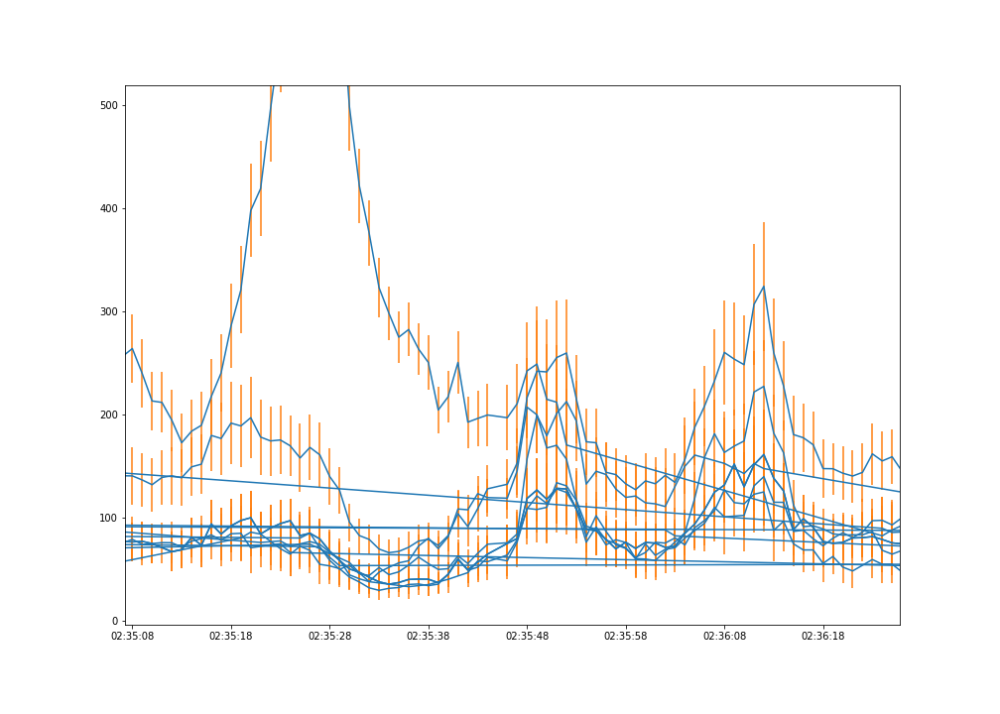

In [36]:

plt.figure(figsize=(14,10))

for i in range(164)[::10]:
    source_df = retrieve_source(aart_cat,i)
    plt.errorbar(source_df.index, source_df.f_int, yerr=source_df.f_int_err, fmt="-",ecolor="C1")


# source_df = retrieve_source(aart_cat,162)
# plt.errorbar(source_df.index, source_df.f_int, yerr=source_df.f_int_err, fmt=".",color="C4",ecolor="C1")

# source_df = retrieve_source(aart_cat,160)
# print source_df.runcatid[0], str(source_df.ra[0]), str(source_df.decl[0])

# plt.errorbar(source_df.index, source_df.f_int, yerr=source_df.f_int_err, fmt=".",color="C3",ecolor="C1")


<IPython.core.display.Javascript object>


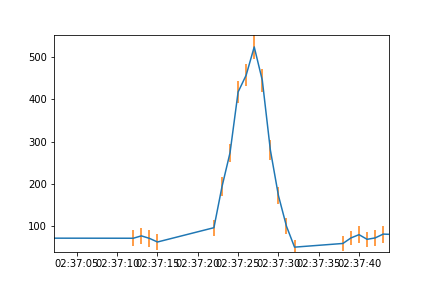

<Container object of 3 artists>

In [35]:
#%matplotlib osx

source_df = retrieve_source(aart_cat,100)

plt.errorbar(source_df.index, source_df.f_int, yerr=source_df.f_int_err, fmt="-",ecolor="C1")

In [74]:
source_df = retrieve_source(aart_cat,160)
print np.median(source_df.f_int), "\pm", np.std(source_df.f_int)

68.565754382 \pm 51.0712013169


<matplotlib.colorbar.Colorbar instance at 0x7f3ebe071368>

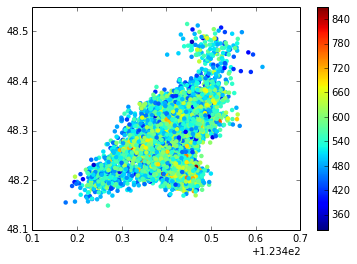

In [26]:
ID = 5
plt.scatter(aart_cat[aart_cat.runcatid == ID].ra, 
            aart_cat[aart_cat.runcatid == ID].decl, 
            c=aart_cat[aart_cat.runcatid == ID].f_int, linewidth =0)
plt.colorbar()


In [30]:
dates = pd.to_datetime(aart_cat.taustart_ts)

In [36]:
lens = [] 
for i in np.unique(aart_cat.runcatid):
    lens.append(len(aart_cat[aart_cat.runcatid == i].f_int))
print np.min(np.array(lens))
print np.max(np.array(lens))

1807
40145


In [34]:
aart_cat.to_csv('AARTFAAC_position-flux-20161112.csv')

#### Perform source association across datasets

In [48]:
removed_id = []
id_associations = {}

x, y = pol2cart(np.abs(90-df.wm_decl.iloc[long_runcats_id].values),
                np.deg2rad(df.wm_ra.iloc[long_runcats_id].values))

dists = sp.spatial.distance.cdist(zip(x,y),zip(x,y))


for i in range(len(long_runcats)):
    if i in removed_id:
        continue
#     assoc_list = list of runcat ids of all sources within distance
    assoc_list = np.where(dists[i] <= 1.0)[0]
#     print long_runcats[assoc_list]
    id_associations[str(long_runcats[assoc_list[0]])] = long_runcats[assoc_list]
    removed_id.extend(assoc_list)

#### Remove sources only present in one observation

In [49]:
print len(id_associations)
count = 0 

multi_id_assoc = {}

for i in id_associations.keys():
    # Require detections on multiple observations
    if len(id_associations[i]) > 1:
        count +=1
        multi_id_assoc[i] = id_associations[i]
        
print count

202
177


#### Make final raw dataframe of all valid detections

In [50]:
count = 0 
first_valid = 0

for key in multi_id_assoc:
    for i in multi_id_assoc[key]:
        if i == multi_id_assoc[key][first_valid]:
            unique_source_df = df[(df.runcatid == int(i)) & (df.extract_type == 0)]
        else:
            unique_source_df = unique_source_df.append(df[(df.runcatid == int(i)) & (df.extract_type == 0)])

        unique_source_df = unique_source_df.drop(['extract_type','f_datapoints','band',
                                              'tau_time','xtrsrc','eta_int',
                                             "v_int",], axis=1)

        unique_source_df.runcatid = count*np.ones(len(unique_source_df.runcatid),dtype=int)
    if len(np.unique(unique_source_df.dataset)) == 1:
        continue 
    if count == 0:
#         print 'first'
        aart_cat = unique_source_df
    else:
#         print 'append'
        aart_cat = aart_cat.append(unique_source_df)
#         print len(aart_cat)
#     print count
    count += 1

# pd.to_datetime(unique_source_df.taustart_ts)
# unique_source_df = unique_source_df.groupby('taustart_ts', as_index=False).mean()
# unique_source_df.set_index(unique_source_df.taustart_ts, inplace=True)


### Save raw data of valid sources from all datasets.


In [51]:
aart_cat.to_csv("fb_flux_aartcat.csv")

###### Skip save and redefine variables to continue 

In [52]:
del data, df, unique_source_df,dists,id_associations,multi_id_assoc, x_space
data = aart_cat
del aart_cat

# Flux calibrate 

#### Load raw data and reference catalogue

In [14]:
# data = pd.read_csv("fb_flux_aartcat.csv",index_col="Unnamed: 0")

data = pd.read_csv("FINAL_fb_flux_aartcat.csv",index_col="Unnamed: 0")
perley =  pd.read_csv("/scratch/mkuiack/perley_fluxes_update.csv")

In [55]:
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)


[('data', 692210616),
 ('x_space', 8096L),
 ('removed_id', 7952),
 ('long_runcats', 7384L),
 ('long_runcats_id', 7384L),
 ('y', 7384L),
 ('DataFrame', 904),
 ('DatetimeTickFormatter', 904),
 ('FontProperties', 904),
 ('NullFormatter', 904),
 ('SkyCoord', 904),
 ('Ateam_dec', 128L),
 ('Ateam_ra', 128L),
 ('collate_trans_data', 120),
 ('distSquared', 120),
 ('dump_list_of_dicts_to_csv', 120),
 ('dump_trans', 120),
 ('extract_data', 120),
 ('figure', 120),
 ('fit', 120L),
 ('fit_func', 120),
 ('nsf', 120),
 ('num_err', 120),
 ('output_notebook', 120),
 ('plot_lightcurve', 120),
 ('pol2cart', 120),
 ('read_src_lc', 120),
 ('retrieve_source', 120),
 ('sem', 120),
 ('show', 120),
 ('assoc_list', 96L),
 ('norm', 64),
 ('all_data_name', 61),
 ('password', 60),
 ('density_estimation', 56),
 ('gridspec', 56),
 ('mdates', 56),
 ('mlab', 56),
 ('np', 56),
 ('pd', 56),
 ('plt', 56),
 ('sp', 56),
 ('u', 56),
 ('host', 55),
 ('engine', 47),
 ('database', 44),
 ('user', 44),
 ('key', 41),
 ('x', 38),


In [12]:
def distSquared(p0, p1):
    distance  = np.sqrt((p0[0] - p1[0,:])**2 + (p0[1] - p1[1,:])**2)
    if len(np.where(distance < 1.0)[0]) > 0:
        return np.where(distance < 1.0)[0]
    else:
        return None
    
data_set = np.array([5,7,1,2,9,3,6,4,8])


ref_cat = pd.DataFrame({'wm_ra':perley.ra,'wm_decl':perley.dec,
                        'f_int':perley.int_flux,'f_int_err':perley.int_flux_err,
                        "N":np.ones(len(perley.int_flux))})

reference_matches = []

for i in data_set:
    count = 0
    
    for _runcat in np.unique(data.runcatid):
        _ra = np.mean(data.wm_ra[(data.dataset == i) & (data.runcatid == _runcat)])
        _dec = np.mean(data.wm_decl[(data.dataset == i) & (data.runcatid == _runcat)])
        
        data_index = distSquared(np.array([_ra, _dec]),
                                 np.array([ref_cat.wm_ra, ref_cat.wm_decl]))
        
        if type(data_index) == np.ndarray:
            count += 1
            
    reference_matches.append(count)
    
reference_matches = np.array(reference_matches)
    
# data_set = data_set[(reference_matches!= 0)]
# reference_matches = reference_matches[(reference_matches!= 0)]
data_set = data_set[np.argsort(reference_matches)[::-1]]

#### Crossmatch with reference catalogue and correct lightcurves 

In [29]:
len(bootstrap.f_int[(np.isfinite(bootstrap.f_int))]

117020

16
('ref cat len', 16)
('ref mathces', 5)
16
('ref cat len', 58)
('ref mathces', 38)
58
('ref cat len', 62)
('ref mathces', 32)
62
('ref cat len', 64)
('ref mathces', 0)
64
('ref cat len', 64)
('ref mathces', 0)
64
('ref cat len', 64)
('ref mathces', 0)
64
('ref cat len', 64)
('ref mathces', 0)
64
('ref cat len', 64)
('ref mathces', 0)
64
('ref cat len', 64)
('ref mathces', 0)


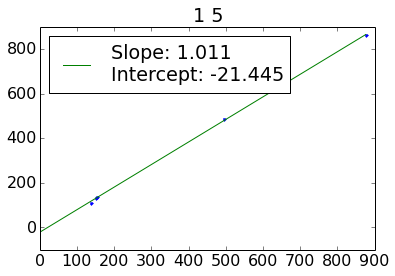

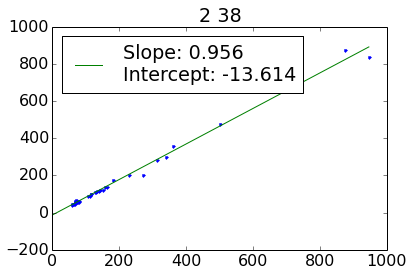

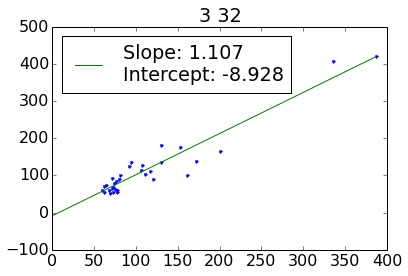

In [14]:
ref_cat = pd.DataFrame({'wm_ra':perley.ra,'wm_decl':perley.dec,
                        'f_int':perley.int_flux,'f_int_err':perley.int_flux_err,
                        "N":np.ones(len(perley.int_flux))})

for i in data_set:

    set_AART = []
    set_perl = [] 
    tmp_data = data[(data.dataset == i)]
    print(len(ref_cat))

    # if not the first dataset, add results from previous dataset to bootstrap catalogue 
    if i != data_set[0]:
        for _runcat in np.unique(bootstrap.runcatid):
#             print "_runcat",_runcat
            src = bootstrap[(bootstrap.runcatid == _runcat)].median(axis=0)
            _new = pd.DataFrame({'wm_ra':[src.wm_ra],'wm_decl':[src.wm_decl],
                                 'f_int':[src.f_int],'f_int_err':[src.f_int_err],
                                 "N":[len(bootstrap[(bootstrap.runcatid == _runcat) & (np.isfinite(bootstrap.f_int)) ].values)]})

            data_index = distSquared(np.array([_new.wm_ra,_new.wm_decl]),
                   np.array([ref_cat.wm_ra, ref_cat.wm_decl]))


            if type(data_index) == np.ndarray:
                ref_cat.wm_ra.iloc[data_index] = np.average([ref_cat.wm_ra.iloc[data_index].values[0],_new.wm_ra.values[0]],
                                                            weights=[ref_cat.N.iloc[data_index].values[0],_new.N.values[0]])
                ref_cat.wm_decl.iloc[data_index] = np.average([ref_cat.wm_decl.iloc[data_index].values[0],_new.wm_decl.values[0]],
                                                            weights=[ref_cat.N.iloc[data_index].values[0],_new.N.values[0]])
                ref_cat.f_int.iloc[data_index] = np.average([ref_cat.f_int.iloc[data_index].values[0],_new.f_int.values[0]],
                                                            weights=[ref_cat.N.iloc[data_index].values[0],_new.N.values[0]])
                ref_cat.f_int_err.iloc[data_index] = np.average([ref_cat.f_int_err.iloc[data_index].values[0],_new.f_int_err.values[0]],
                                                            weights=[ref_cat.N.iloc[data_index].values[0],_new.N.values[0]])
                ref_cat.N.iloc[data_index] += _new.N.values[0]
            else:
                ref_cat = pd.concat([ref_cat,_new], ignore_index=True)
    print("ref cat len",len(ref_cat))
    
    for _ref_src in ref_cat.index:

        cat_x, cat_y = pol2cart(np.abs(90-tmp_data.wm_decl.values),
                np.deg2rad(tmp_data.wm_ra.values))
        
        ref_x, ref_y = pol2cart(np.abs(90-ref_cat.wm_decl.iloc[_ref_src]),
                np.deg2rad(ref_cat.wm_ra.iloc[_ref_src]))
        
        
        data_index = distSquared((ref_x,ref_y),
                   np.array([cat_x, cat_y]))
        
        if type(data_index) == np.ndarray:
#             plt.figure()
#             plt.title(_source)
#             plt.plot(pd.to_datetime(tmp_data.taustart_ts.iloc[data_index]), tmp_data.f_int.iloc[data_index], ".")
#             plt.xticks(rotation=-20)
            set_perl.append(np.float(ref_cat.f_int.iloc[_ref_src]))
            set_AART.append(np.median(tmp_data.f_int.iloc[data_index]))
    print("ref mathces",len(set_perl))
    if len(set_perl) == 0:
        continue
    
    plt.figure()
    plt.title(str(i)+" "+str(len(set_AART)))
    plt.plot(set_perl,set_AART,".")

    fit = np.polyfit(set_perl,set_AART,1)
#     corrected_data.f_int[(corrected_data.dataset == i)] = (corrected_data.f_int[(corrected_data.dataset == i)]-fit[1])/fit[0]
    bootstrap = tmp_data.copy(deep=True)
    bootstrap.f_int = (bootstrap.f_int-fit[1])/fit[0]
    bootstrap.f_int_err = (bootstrap.f_int_err)/fit[0]
    if i != data_set[0]:
        corrected = pd.concat([corrected,bootstrap], ignore_index=True)
    else:
        corrected = bootstrap.copy(deep=True)
    
    plt.plot(np.linspace(0,np.max(set_perl)),
             fit[1]+np.linspace(0,np.max(set_perl))*fit[0],
             label="Slope: {}\nIntercept: {}".format(round(fit[0],3), round(fit[1],3)))
    plt.legend(loc="upper left")

In [11]:
ref_cat.to_csv("simple_AARTFAAC_flux-reference.csv")

In [16]:
for i in np.unique(data.runcatid):
    if (np.mean(data[data.runcatid == i].ra) > 23) & \
    (np.mean(data[data.runcatid == i].ra) < 26) :
        print i, '\t', np.round(np.mean(data[data.runcatid == i].f_int),2), '\t', np.mean(data[data.runcatid == i].ra), '\t', np.mean(data[data.runcatid == i].decl)

32 	93.49 	24.4708090867 	21.0882080152
117 	94.87 	24.8369953772 	33.2894455482


In [24]:
# x = plot_lightcurve(data, 117, stdout=False)
source_df = retrieve_source(data, 117)

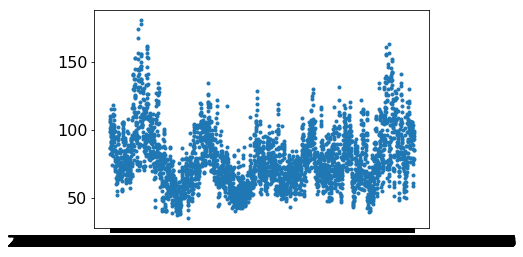

In [31]:
plt.plot(source_df.f_int.iloc[:3600], ".")

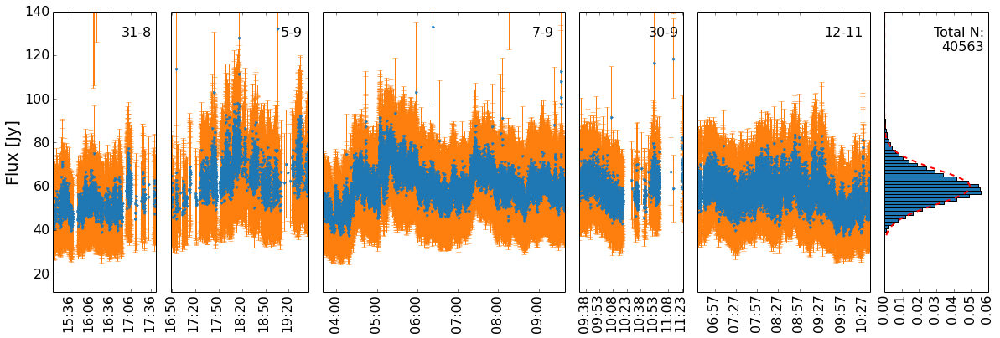

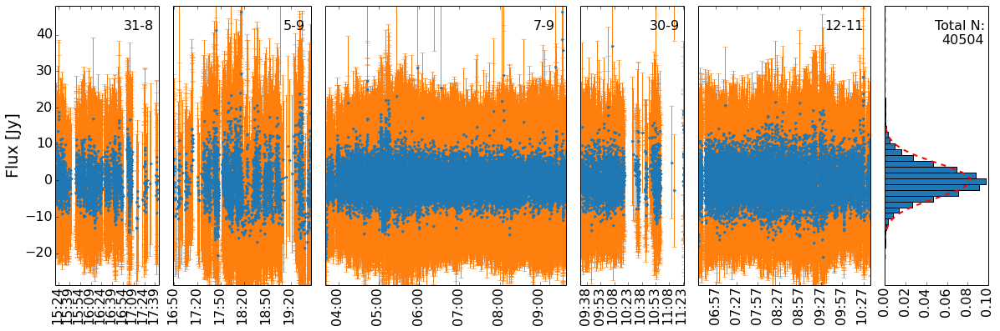

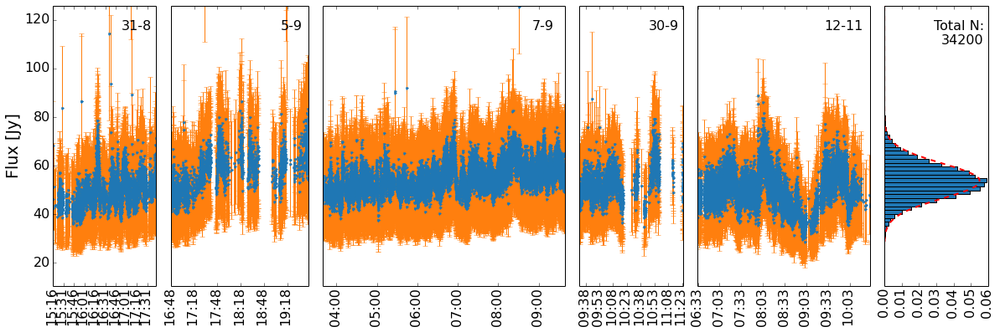

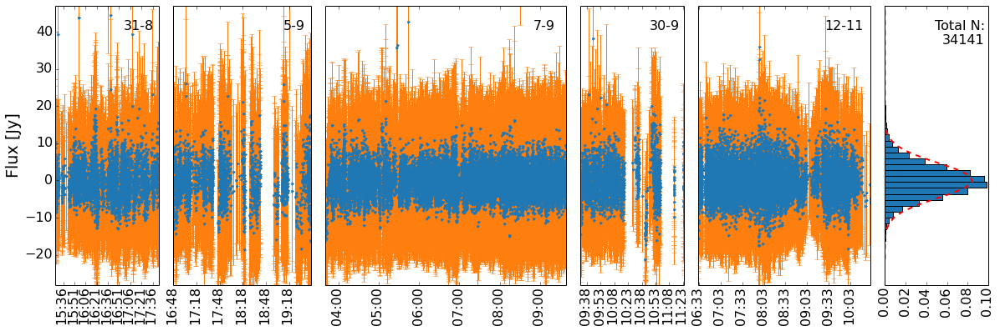

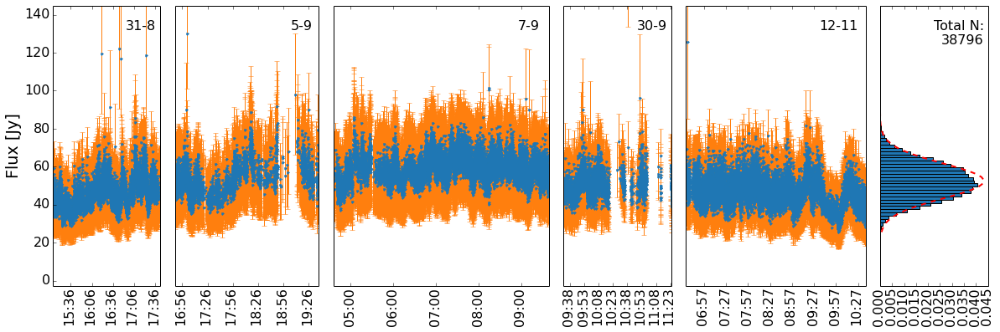

...

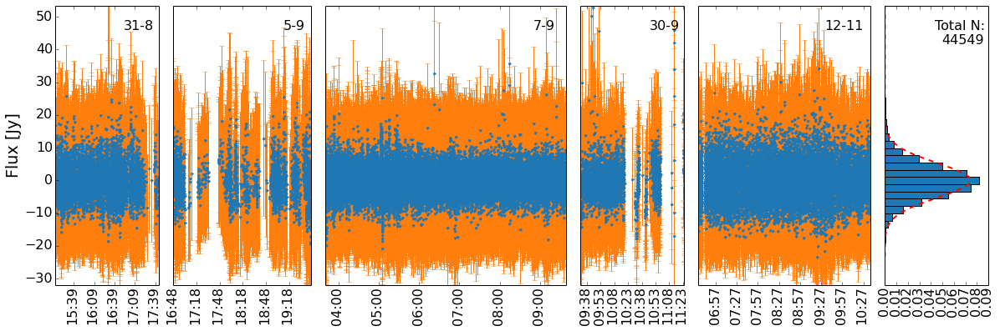

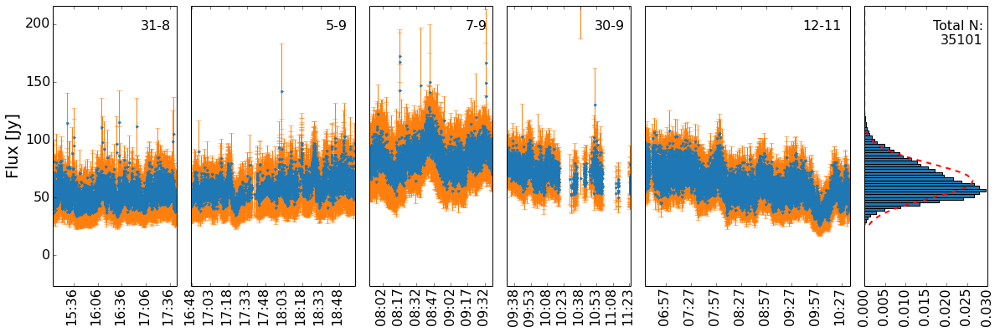

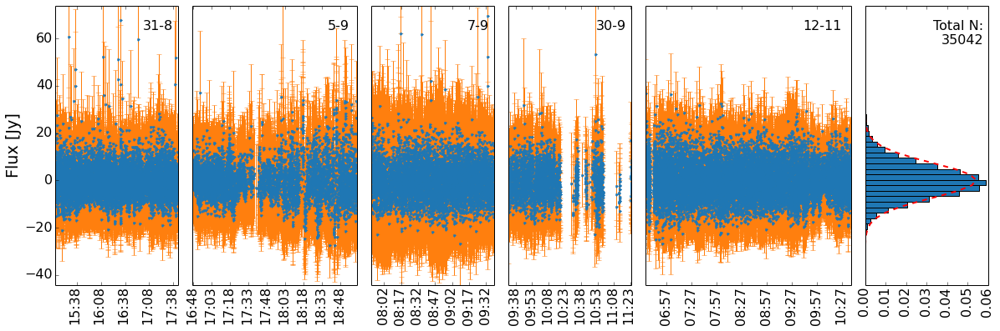

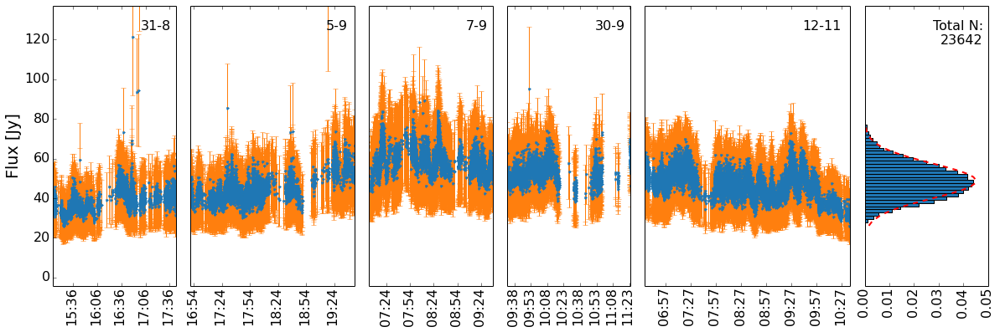

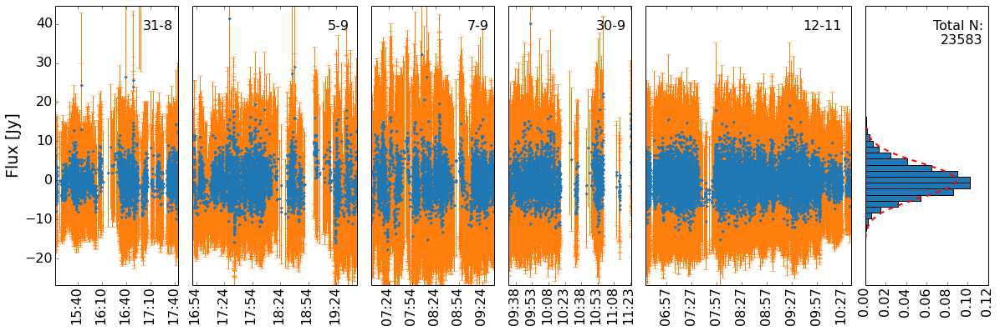

In [36]:
for i in np.unique(data.runcatid):
#     print i, len(np.unique(data[data.runcatid == i].dataset))
    if len(np.unique(data[data.runcatid == i].dataset)) == 5:    
        plot_lightcurve(data,i,stdout=False)
        plot_lightcurve(data,i, ion_sub=True,stdout=False)
# plt.show()

In [25]:
perley


,Source,ra,dec,a0,e0,a1,e1,a2,e2,a3,e3,a4,e4,a5,e5,X,freq,int_flux,int_flux_err
0,J0133-3629,23.490571,-36.493308,1.0440,0.0010,-0.6620,0.0020,-0.2250,0.0060,NaN,NaN,NaN,NaN,NaN,NaN,267.0,0.2 ? 4,32.7800,0.96
1,3C48,24.422071,33.159756,1.3253,0.0005,-0.7553,0.0009,-0.1914,0.0011,0.0498,0.0009,NaN,NaN,NaN,NaN,3.1,0.05 ? 50,74.5100,0.65
2,Fornax A,50.674121,-37.208200,2.2180,0.0030,-0.6610,0.0060,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,0.2 ? 0.5,1038.2000,23.02
3,3C123,69.268230,29.670505,1.8017,0.0007,-0.7884,0.0012,-0.1035,0.0023,-0.0248,0.0013,0.0090,0.0013,NaN,NaN,1.9,0.05 ? 50,473.8400,3.87
4,J0444-2809,71.157112,-28.165114,0.9710,0.0011,-0.8940,0.0040,-0.1180,0.0100,NaN,NaN,NaN,NaN,NaN,NaN,3.3,0.2 ? 2.0,77.4000,3.23
5,3C138,80.291186,16.639410,1.0088,0.0009,-0.4981,0.0022,-0.1550,0.0030,-0.0100,0.0700,0.0220,0.0030,NaN,NaN,1.5,0.2 ? 50,25.9200,2.55
6,Pictor A,79.957179,-45.778848,1.9380,0.0010,-0.7470,0.0013,-0.0740,0.0050,NaN,NaN,NaN,NaN,NaN,NaN,8.1,0.2 ? 4.0,548.9100,13.63
7,3C147,85.651103,49.851968,1.4516,0.0010,-0.6961,0.0017,-0.2010,0.0050,0.0640,0.0040,-0.0460,0.0040,0.029,0.003,2.2,0.05 ? 50,50.5604,0.65
8,3C196,123.400208,48.217397,1.2872,0.0007,-0.8530,0.0012,-0.1530,0.0020,-0.0200,0.0013,0.0201,0.0013,NaN,NaN,1.6,0.050 ? 50,151.8100,1.23
9,Hydra A,139.523546,-12.095553,1.7795,0.0009,-0.9176,0.0012,-0.0840,0.0040,-0.0139,0.0014,0.0300,0.0030,NaN,NaN,3.5,0.050 ? 12,734.0900,5.05


#### Make corrected AARTFAAC catalogue

In [17]:
# Mean repeated timestamps
for ID in np.unique(corrected.runcatid):
#     print ID
    source_df = corrected[corrected.runcatid == ID]
    pd.to_datetime(source_df.taustart_ts)
    source_df = source_df.groupby('taustart_ts', as_index=False).mean()
    source_df.set_index(source_df.taustart_ts, inplace=True)

    if ID != 0:
        new_corrected = pd.concat([new_corrected,source_df], ignore_index=True)
    else:
        new_corrected = source_df.copy(deep=True)


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50


In [37]:
# Mean repeated timestamps
for ID in np.unique(data.runcatid):
#     print ID
    source_df = data[data.runcatid == ID]
    pd.to_datetime(source_df.taustart_ts)
    source_df = source_df.groupby('taustart_ts', as_index=False).mean()
    source_df.set_index(source_df.taustart_ts, inplace=True)

    if ID != 0:
        new_data = pd.concat([new_data,source_df], ignore_index=True)
    else:
        new_data = source_df.copy(deep=True)


In [58]:
len(bimode_IDs)

0

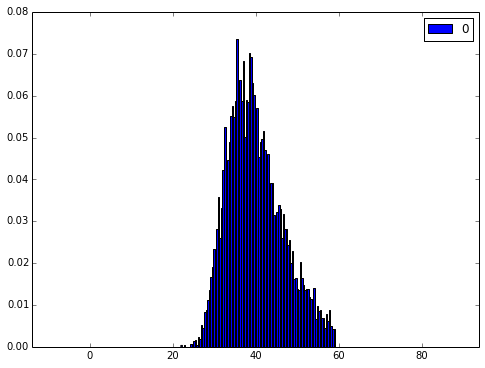

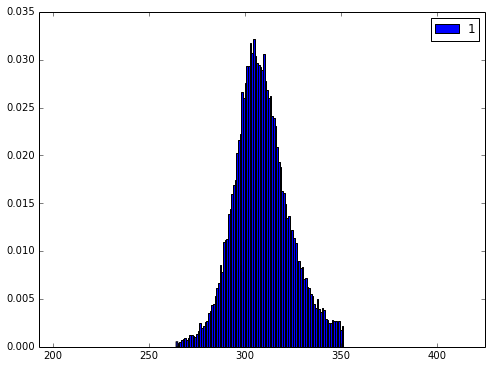

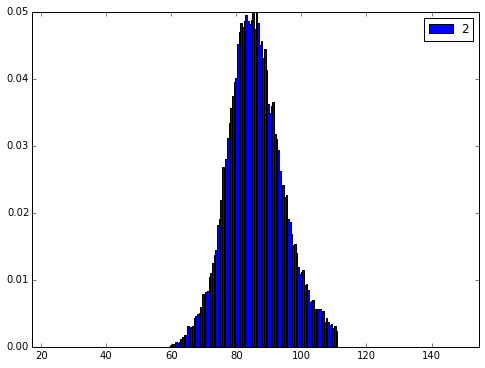

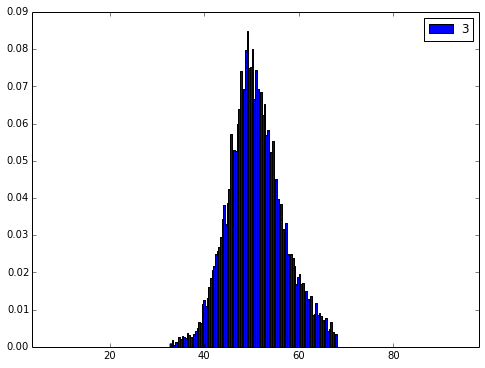

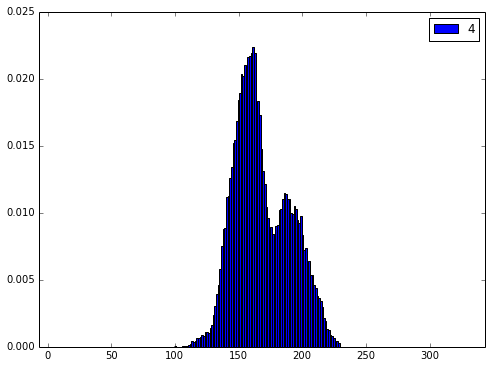

...

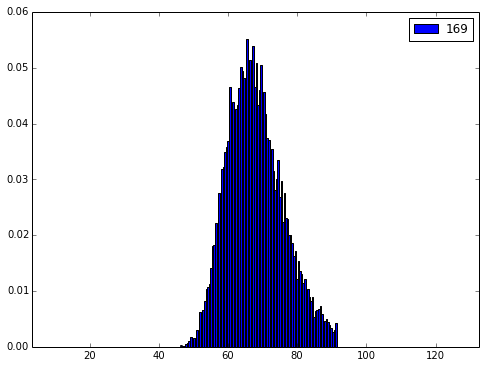

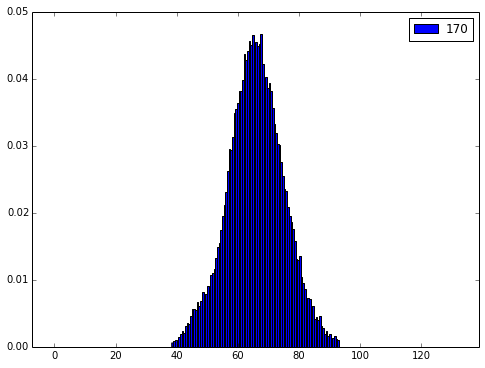

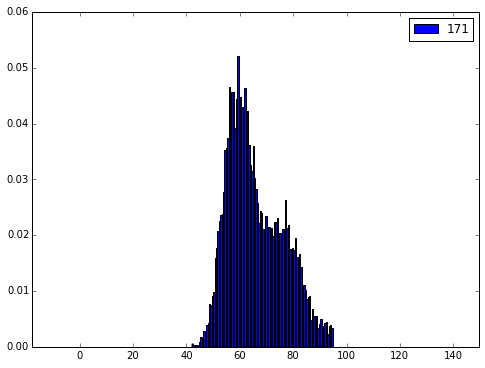

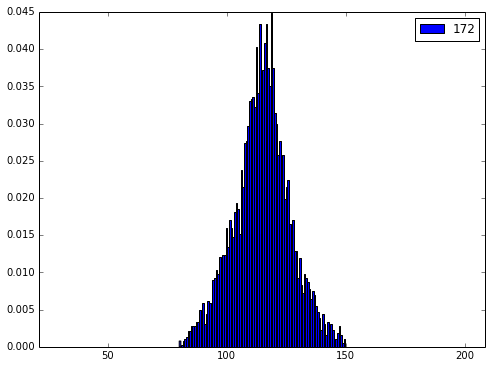

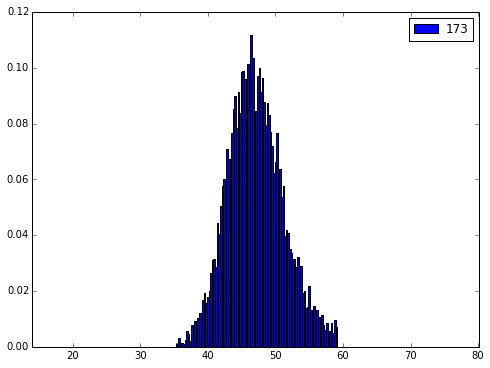

In [64]:
def gauss(x,mu,sigma,A):
    return A*exp(-(x-mu)**2./2./sigma**2.)

def bimodal(x,mu1,sigma1,A1,mu2,sigma2,A2):
    return gauss(x,mu1,sigma1,A1)+gauss(x,mu2,sigma2,A2)

bimode_IDs = []
for _ID in np.unique(data.runcatid):
    source_df = retrieve_source(data,_ID)
    plt.figure(figsize=(8,6))
    y,x,_ = plt.hist(clip(source_df.f_int),100,normed=True,label=str(_ID))

    (mu, sigma) = norm.fit(clip(source_df.f_int))

#     plt.plot(x,bimodal(x,*params),color='red',lw=3,label='model')
    plt.xlim([mu-8*sigma,mu+8*sigma])
    plt.legend()
    plt.show()
#     print params[0], params[1], params[2]
#     print params[3], params[4], params[5]

In [41]:
params

array([ 7.27774991e+01,  5.86268386e+00, -1.78246321e-02,  8.26031132e+01,
        9.65739521e+00,  5.12725010e-02])

In [74]:
print skew_mode(0, 0, fit[2])
print fit[0]+skew_mode(0, 0, fit[2]) * fit[2]

0.46226365731592645
33.543126614350406


TypeError: skew_mode() takes exactly 1 argument (3 given)

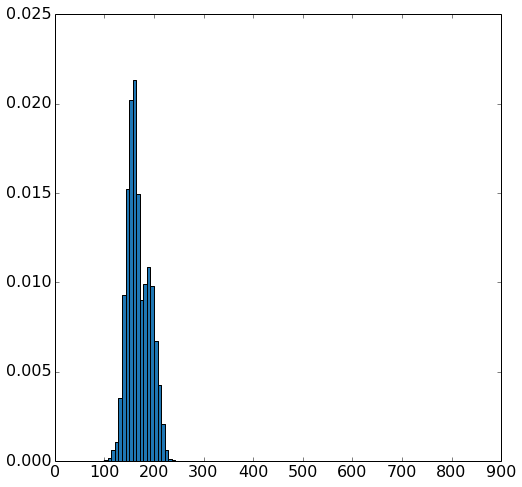

In [153]:
source_df = retrieve_source(new_corrected,4)

plt.figure(figsize=(8,8))
# n, bins, patches   =  plt.hist(clip(source_df.f_int),
#                                bins=100,normed=1,facecolor="#1f77b4")
# (mu, sigma) = norm.fit(clip(source_df.f_int))

n, bins, patches   =  plt.hist(source_df.f_int,
                               bins=100,normed=1,facecolor="#1f77b4")
(mu, sigma) = norm.fit(source_df.f_int)



fit,cov = scipy.optimize.curve_fit(skewnorm,bins[1:],n,p0=(mu,sigma,1.0))

x = np.linspace(fit[0]-8*fit[1],fit[0]+8*fit[1],10000)

sk_mode = fit[0]+skew_mode(0, 0, fit[2]) * fit[1]
p = skewnorm(x,fit[0],fit[1],fit[2])
plt.plot(x,p,lw=3,c="r",label="Loc: {}""\n""Mode: {}""\n""Scale: {}""\n""Skew: {}".format(round(fit[0],2),
                                                                                          round(sk_mode,2),
                                                                                          round(fit[1],2),
                                                                                          round(fit[2],2)))
plt.plot(x,gauss(x,mu,sigma,np.max(p)), c="lightgreen",lw=3)
x_pos = fit[0]+skew_mode(0, 0, fit[2]) * fit[1]
plt.plot([x_pos,x_pos], [0,1.2*np.max(p)], lw=3, c="red")


plt.xlim([mu-3*sigma,mu+3*sigma])
plt.legend()






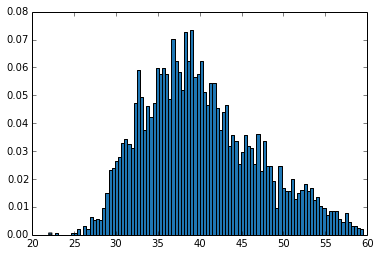

In [105]:
n, bins, patches   =  plt.hist(clip(fluxes),
                               bins=100,normed=1,facecolor="#1f77b4")
                               
n1, bins1  =  np.histogram(clip(fluxes),
                                      bins=100,normed=1)

In [144]:
np.unique(new_corrected.runcatid)[1:2]

array([1])

In [148]:
def powlaw(x,A,B):
    return A*x**B

for _ID in np.unique(new_corrected.runcatid)[3:]:
    source_df = retrieve_source(new_corrected,_ID)
    mode_std = []
    lens = [] 
    for light_frac in [0.01,0.02,0.05,0.07,0.1,0.2,0.5]:
        tmp_modes = [] 
        tmp_mode_ranges = []
        tmp_lens = [] 
        t1 = time.time()
        for num_runs in np.arange(1000):
            fluxes = np.random.choice(clip(source_df.f_int),
                                      int(light_frac*len(clip(source_df.f_int))))

            # fluxes = source_df.f_int

        #     plt.figure(figsize=(12,6))
        #     plt.subplot(121)
        #     n, bins, patches   =  plt.hist(clip(fluxes),
        #                                    bins=100,normed=1,facecolor="#1f77b4")
#             n, bins  =  np.histogram(clip(fluxes),
#                                               bins=100,normed=1)
#             (mu, sigma) = norm.fit(clip(fluxes))
            
            n, bins  =  np.histogram(fluxes,
                                              bins=100,normed=1)

            (mu, sigma) = norm.fit(fluxes)

            try:
                fit,cov = scipy.optimize.curve_fit(skewnorm,bins[1:],n,p0=(mu,sigma,1.0))
            except RuntimeError:
                continue 

            tmp_modes.append(sk_mode(fit[0],fit[1],fit[2]))
            tmp_mode_ranges.append(delta_sk_mode(np.sqrt(cov[0,0]),
                                            fit[1],np.sqrt(cov[1,1]),
                                            fit[2],np.sqrt(cov[2,2])))
            tmp_lens.append(len(fluxes))

#         mode_std.append(np.std(tmp_modes))
        mode_std.append(np.median(tmp_mode_ranges))
        lens.append(np.mean(tmp_lens))

    powlawfit, powlawcov = scipy.optimize.curve_fit(powlaw, lens, mode_std)


    print _ID, powlawfit[1], len(fluxes)
#     plt.figure(1)
#     plt.plot(lens,mode_std)
#     plt.show()
# #     x = np.linspace(fit[0]-8*fit[1],fit[0]+8*fit[1],100)
#     x_pos = sk_mode(fit[0], fit[1],fit[2])

#     p = skewnorm(x,fit[0],fit[1],fit[2])
#     plt.plot(x,p,lw=3,c="r",label="Loc: {}""\n""Mode: {}""\n""Scale: {}""\n""Skew: {}".format(round(fit[0],2),
#                                                                                           round(x_pos,2),
#                                                                                           round(fit[1],2),
#                                                                                           round(fit[2],2)))

#     plt.plot([x_pos,x_pos], [0,np.max(p)*1.1], "--",lw=3)

#     plt.plot([mu,mu], [0,np.max(p)*1.1], "--", c="lightgreen",lw=3)



#     plt.xlim([mu-5*sigma,mu+5*sigma])
#     plt.legend()
#     print "Loc:",round(fit[0],3),"\pm", round(np.sqrt(cov[0,0]),3)
#     print "Scale:",round(fit[1],3),"\pm", round(np.sqrt(cov[1,1]),3)
#     print "Skew:",round(fit[2],3),"\pm", round(np.sqrt(cov[2,2]),3)
#     print "Skewness is likely "+str(fit[2] > 10*np.sqrt(15./len(source_df[np.isfinite(source_df.f_int)].f_int)))
#     # print "mu/mode:", mu/x_pos
#     print "mode: ", sk_mode(fit[0],fit[1],fit[2])
#     print "d_mode:", delta_sk_mode(np.sqrt(cov[0,0]),
#                                     fit[1],np.sqrt(cov[1,1]),
#                                     fit[2],np.sqrt(cov[2,2]))


3 -0.42379964123301184 5368
4 -0.19195909116471696 24357


KeyboardInterrupt: 

-0.5616965346860693


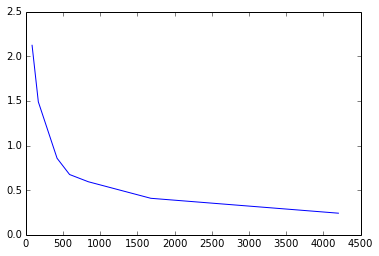

In [144]:
def powlaw(x,A,B):
    return A*x**B

powlawfit, powlawcov = scipy.optimize.curve_fit(powlaw, lens, mode_std)

print powlawfit[1]
plt.plot(lens,mode_std)

In [149]:

source_df = retrieve_source(new_corrected,4)

print(len(source_df.f_int))

tmp_modes = [] 
tmp_mode_ranges = []
tmp_lens = [] 
t1 = time.time()
light_frac = 0.1
t1 = time.time()
for num_runs in np.arange(2000):
    fluxes = np.random.choice(source_df.f_int, int(light_frac*len(source_df.f_int)))
    # fluxes = source_df.f_int

#     plt.figure(figsize=(12,6))
#     plt.subplot(121)
#     n, bins, patches   =  plt.hist(clip(fluxes),
#                                    bins=100,normed=1,facecolor="#1f77b4")
    n, bins  =  np.histogram(fluxes,
                                      bins=100,normed=1)

    (mu, sigma) = norm.fit(fluxes)
    try:
        fit,cov = scipy.optimize.curve_fit(skewnorm,bins[1:],n,p0=(mu,sigma,1.0))
    except RuntimeError:
        continue 
    tmp_modes.append(sk_mode(fit[0],fit[1],fit[2]))
    tmp_mode_ranges.append(delta_sk_mode(np.sqrt(cov[0,0]),
                                    fit[1],np.sqrt(cov[1,1]),
                                    fit[2],np.sqrt(cov[2,2])))

print np.std(tmp_modes)
print np.median(tmp_mode_ranges)
print "time:", time.time() - t1

48769
1.0101484646513075
0.86478138100146
time: 17.7589740753


6.621031313428688
1.0101484646513075
0.86478138100146


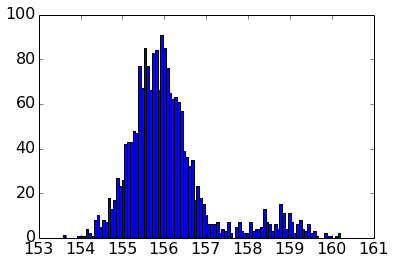

In [150]:
print max(tmp_modes)-min(tmp_modes)
print np.std(tmp_modes)
print np.median(tmp_mode_ranges)

h = plt.hist(np.array(tmp_modes),bins=100)

36.130113370132996 43.09530827369481
2016-09-07T03:40:15.736000000
2016-11-12T17:16:50.462000000
2016-11-13T20:00:10.543000000
2016-12-10T22:55:10.560000000
2016-12-11T00:00:00.190000000
Gaus fit: mu 101.928, sigma 12.134


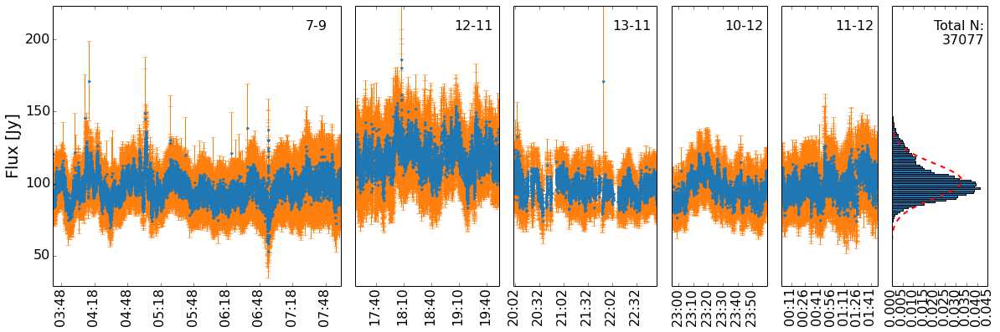

In [152]:
p = plot_lightcurve(new_corrected,5)

Loc: 63.276 \pm 0.222
Scale: 42.002 \pm 0.348
Skew: 3.061 \pm 0.094
Skewness is likely True
mode:  83.1772451186
d_mode: 0.265100856522


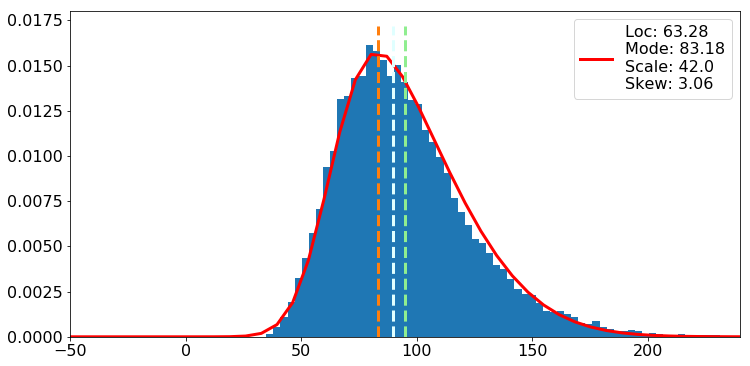

In [38]:
skewnesses = [] 

bimodal = []
# n, bins, patches   =  plt.hist(clip(source_df.f_int),
#                                bins=100,normed=1,facecolor="#1f77b4")
# (mu, sigma) = norm.fit(clip(source_df.f_int))

# n, bins, patches   =  plt.hist(source_df.f_int,
#                                bins=100,normed=True,facecolor="#1f77b4")
# (mu, sigma) = norm.fit(source_df.f_int)
roll_len = 1*60
roll_type = 'triang'

# for _ID in ref_cat[ref_cat.f_int_err > 1].runcatid:
source_df = retrieve_source(data,117)

plt.figure(figsize=(12,6))
# plt.subplot(121)
# n, bins, patches   =  plt.hist(clip(source_df.f_int),
#                                bins=100,normed=1,facecolor="#1f77b4")
# (mu, sigma) = norm.fit(clip(source_df.f_int))

n, bins, patches   =  plt.hist(source_df.f_int,
                               bins=100,normed=1,facecolor="#1f77b4")
(mu, sigma) = norm.fit(source_df.f_int)


fit,cov = scipy.optimize.curve_fit(skewnorm,bins[1:],n,p0=(mu,sigma,1.0))

#     if ((fit[2] - np.sqrt(cov[2,2])) < 0.0) and ((fit[2] + np.sqrt(cov[2,2])) > 0.0):


x = np.linspace(fit[0]-8*fit[1],fit[0]+8*fit[1],100)

p = skewnorm(x,fit[0],fit[1],fit[2])
x_pos = sk_mode(fit[0],fit[1],fit[2])
plt.plot(x,p,lw=3,c="r",label="Loc: {}""\n""Mode: {}""\n""Scale: {}""\n""Skew: {}".format(round(fit[0],2),
                                                                                      round(x_pos,2),
                                                                                      round(fit[1],2),
                                                                                      round(fit[2],2)))

plt.plot([x_pos,x_pos], [0,np.max(p)*1.1], "--",lw=3)
plt.plot([mu,mu], [0,np.max(p)*1.1], "--", c="lightgreen",lw=3)
plt.plot([np.median(clip(source_df.f_int)),np.median(clip(source_df.f_int))], [0,np.max(p)*1.1], "--", c="lightcyan",lw=3)

plt.xlim([mu-5*sigma,mu+5*sigma])
plt.legend()
print "Loc:",round(fit[0],3),"\pm", round(np.sqrt(cov[0,0]),3)
print "Scale:",round(fit[1],3),"\pm", round(np.sqrt(cov[1,1]),3)
print "Skew:",round(fit[2],3),"\pm", round(np.sqrt(cov[2,2]),3)
print "Skewness is likely "+str(fit[2] > 10*np.sqrt(15./len(source_df[np.isfinite(source_df.f_int)].f_int)))
print "mode: ", sk_mode(fit[0],fit[1],fit[2])
print "d_mode:", delta_sk_mode(np.sqrt(cov[0,0]),
                                fit[1],np.sqrt(cov[1,1]),
                                fit[2],np.sqrt(cov[2,2]))
#     print "#### subbed"
    
#     rolling = source_df.f_int.rolling(roll_len, win_type=roll_type)
#     source_df.f_int = source_df.f_int-rolling.mean()
    
#     plt.subplot(122)
#     n, bins, patches   =  plt.hist(clip(source_df.f_int),
#                                    bins=100,normed=1,facecolor="#1f77b4")
#     (mu, sigma) = norm.fit(clip(source_df.f_int))
    
#     fit,cov = scipy.optimize.curve_fit(skewnorm,bins[1:],n,p0=(mu,sigma,1.0))
    
#     x = np.linspace(fit[0]-8*fit[1],fit[0]+8*fit[1],100)
#     p = skewnorm(x,fit[0],fit[1],fit[2])
#     x_pos = sk_mode(fit[0],fit[1],fit[2])
#     plt.plot(x,p,lw=3,c="r",label="Loc: {}""\n""Mode: {}""\n""Scale: {}""\n""Skew: {}".format(round(fit[0],2),
#                                                                                           round(x_pos,2),
#                                                                                           round(fit[1],2),
#                                                                                           round(fit[2],2)))
#     plt.plot([x_pos,x_pos], [0,np.max(p)*1.1], "--",lw=3)
#     plt.plot([mu,mu], [0,np.max(p)*1.1], "--", c="lightgreen",lw=3)
#     plt.plot([np.median(clip(source_df.f_int)),np.median(clip(source_df.f_int))], [0,np.max(p)*1.1], "--", c="lightcyan",lw=3)
    
#     plt.xlim([mu-5*sigma,mu+5*sigma])
#     plt.legend()

plt.show()
#     print "Loc:",round(fit[0],3),"\pm", round(np.sqrt(cov[0,0]),3)
#     print "Scale:",round(fit[1],3),"\pm", round(np.sqrt(cov[1,1]),3)
#     print "Skew:",round(fit[2],3),"\pm", round(np.sqrt(cov[2,2]),3)
#     print "Skewness is likely "+str(fit[2] > 10*np.sqrt(15./len(source_df[np.isfinite(source_df.f_int)].f_int)))
#     print "mode: ", sk_mode(fit[0],fit[1],fit[2])
#     print "d_mode:", delta_sk_mode(np.sqrt(cov[0,0]),
#                                     fit[1],np.sqrt(cov[1,1]),
#                                     fit[2],np.sqrt(cov[2,2]))
    
#     print "#### next"
#     skewnesses.append(fit[2])
#     if skewnesses > 3:
#         bimodal.append(_ID)
    

253.111283207949 4.97454162141428
2016-08-31T16:23:58.926000000
2016-09-05T16:47:14.725000000
2016-11-12T11:38:34.689000000
2016-11-14T11:30:37.116000000
Gaus fit: mu 873.324, sigma 41.707


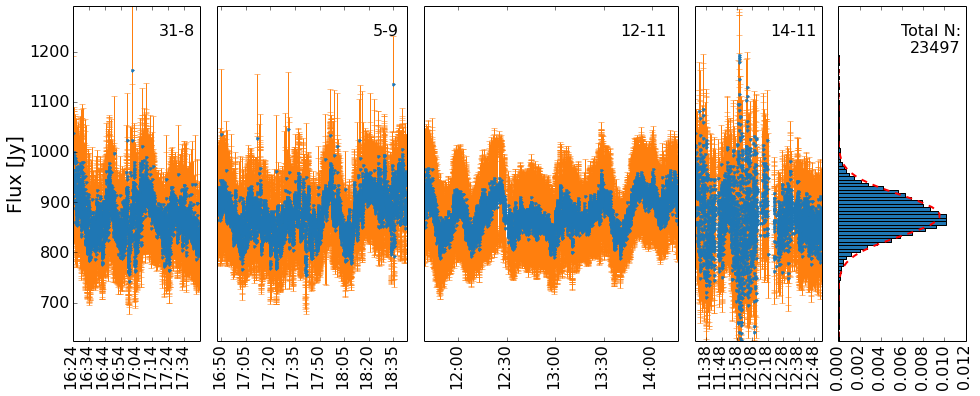

In [21]:
p = plot_lightcurve(new_corrected,42)

In [173]:
for i in np.unique(ref_cat.runcatid):
    print i, '\t',float(ref_cat[ref_cat.runcatid == i].f_int),'\t', \
    float(ref_cat[ref_cat.runcatid == i].ra), '\t',\
    float(ref_cat[ref_cat.runcatid == i].decl)

0 	37.0072135335 	176.833485555 	49.644181322
1 	305.898595878 	50.2972068541 	41.6823890495
2 	84.4293522247 	52.4426285985 	55.3872770922
3 	49.8935172004 	45.6509500485 	50.8668314311
4 	155.57685764 	35.1038394532 	62.5581902089
5 	96.5687494093 	36.1277408649 	43.0517814506
6 	41.0678193202 	130.001037762 	65.1697198892
7 	46.159945373 	67.1629105915 	76.9459888244
8 	64.5993526236 	133.764474473 	13.906634694
9 	39.3679426288 	106.851540426 	63.3260526027
10 	61.8119632 	101.69545957 	21.3538806975
11 	56.8093395714 	104.467530435 	54.2252431646
12 	58.2807890011 	158.861774631 	58.1771056368
13 	61.5061134309 	176.746889255 	31.5252235731
14 	53.2598588191 	108.122873256 	74.8277570304
16 	58.9784376681 	194.956207652 	27.8161850485
17 	462.536764928 	69.6707746854 	29.7445737038
18 	61.3782151248 	168.930074497 	40.5538828738
19 	81.1743841793 	176.604626539 	19.5730424067
20 	43.9104258066 	130.389577286 	57.884977579
21 	53.8027793601 	117.755839941 	55.8277738403
22 	49.9974

176.819327266508 49.6534893521723
2016-11-12T06:32:12.565000000
2016-11-14T05:01:20.628000000
Gaus fit: mu 40.59, sigma 7.78
50.29379060703079 41.7082068995435
2016-09-07T03:40:15.736000000
2016-11-12T18:19:08.090000000
2016-11-13T20:00:10.543000000
2016-12-10T22:55:10.560000000
2016-12-11T00:00:00.190000000
Gaus fit: mu 314.452, sigma 24.6
52.4303977721573 55.4204029220424
2016-09-07T03:40:15.736000000
2016-11-12T17:17:49.854000000
2016-11-13T20:00:10.543000000
2016-12-10T22:55:10.560000000
2016-12-11T00:00:00.190000000
Gaus fit: mu 86.448, sigma 9.555
45.6421135637802 50.871669482034505
2016-09-07T03:40:15.736000000
2016-12-10T22:56:10.958000000
2016-12-11T00:00:00.190000000
Gaus fit: mu 51.068, sigma 7.929
35.0741029960803 62.617310555772896
2016-09-07T03:40:15.736000000
2016-11-12T15:23:51.796000000
2016-11-13T20:00:10.543000000
2016-12-10T22:55:10.560000000
2016-12-11T00:00:00.190000000
Gaus fit: mu 168.261, sigma 22.263
36.130113370132996 43.095308273694805
2016-09-07T03:40:15.73

2016-12-11T00:00:00.190000000
Gaus fit: mu 59.518, sigma 7.989
221.873545215232 76.99161186183841
2016-08-31T15:10:21.820000000
2016-09-07T03:40:18.808000000
2016-11-12T06:32:19.611000000
2016-11-14T05:01:10.562000000
2016-12-10T22:55:10.560000000
2016-12-11T00:00:00.190000000
Gaus fit: mu 48.36, sigma 8.843
150.874559483699 28.648813803252697
2016-09-07T06:23:35.360000000
2016-09-30T09:31:14.717000000
2016-11-12T06:32:11.558000000
2016-11-14T05:01:10.562000000
2016-12-11T00:10:22.289000000
Gaus fit: mu 101.53, sigma 20.475
253.111283207949 4.97454162141428
2016-08-31T16:23:58.926000000
2016-09-05T16:47:14.725000000
2016-11-12T11:38:34.689000000
2016-11-14T11:30:37.116000000
Gaus fit: mu 873.324, sigma 41.707
215.60500237198502 41.691971230348294
2016-11-12T06:32:18.604000000
2016-11-14T05:14:23.789000000
Gaus fit: mu 45.999, sigma 8.594
167.182420942543 76.9838451040589
2016-08-31T15:15:07.704000000
2016-09-05T16:47:23.784000000
2016-09-07T03:40:20.821000000
2016-09-30T09:31:15.724000

KeyboardInterrupt: 

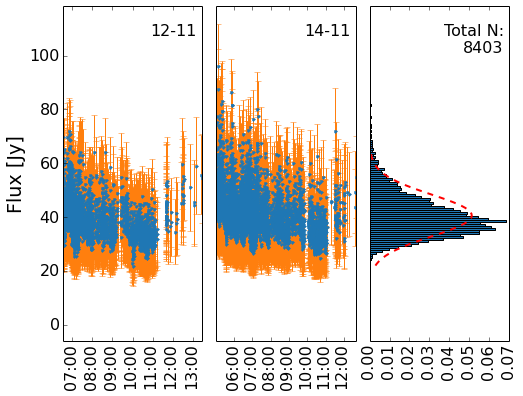

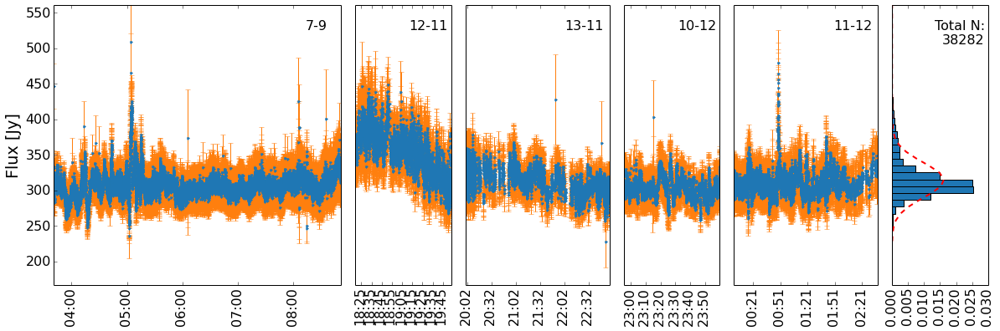

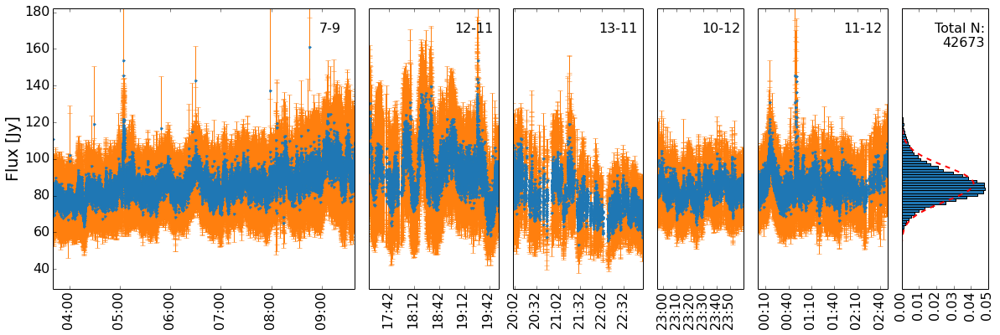

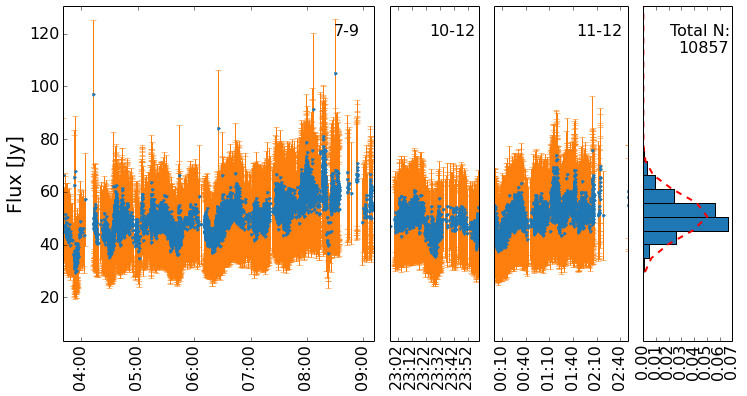

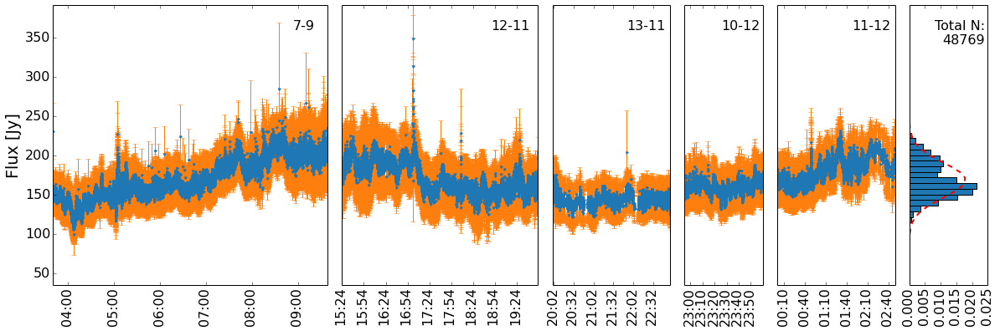

...

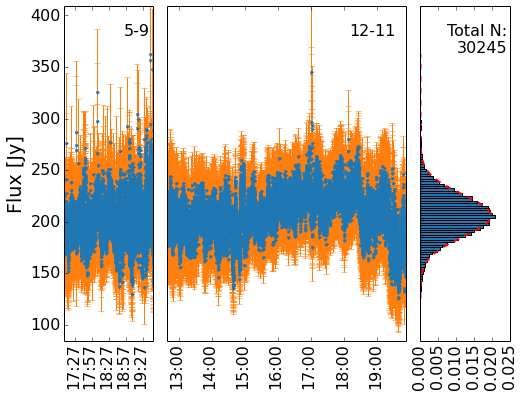

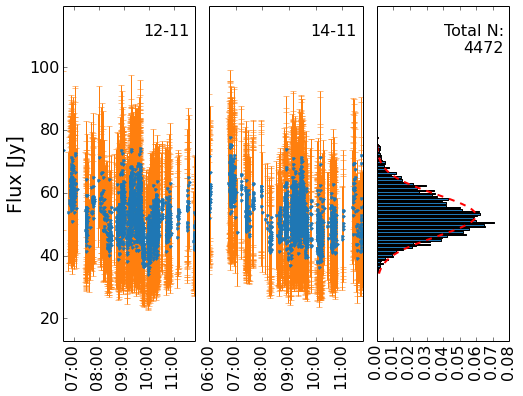

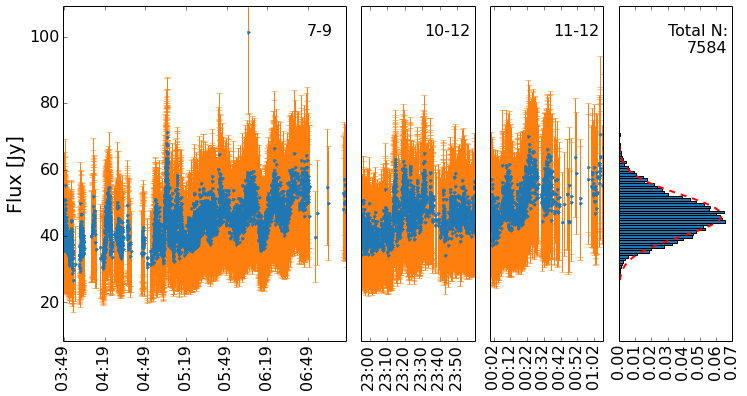

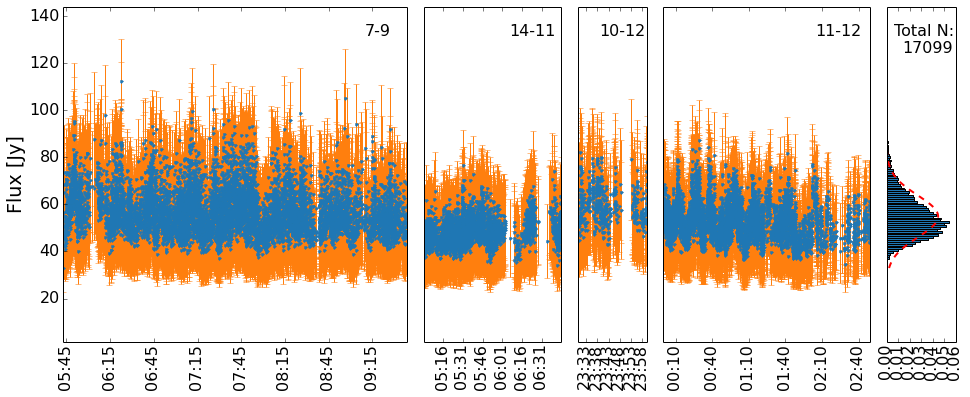

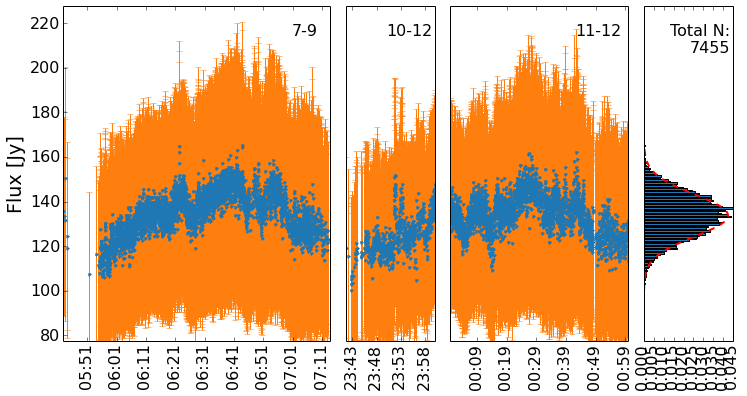

ERROR:tornado.general:Uncaught exception, closing connection.
Traceback (most recent call last):
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 414, in _run_callback
    callback(*args, **kwargs)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/tornado/stack_context.py", line 277, in null_wrapper
    return fn(*args, **kwargs)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 283, in dispatcher
    return self.dispatch_shell(stream, msg)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 235, in dispatch_shell
    handler(stream, idents, msg)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 399, in execute_request
    user_expressions, allow_stdin)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/ipkernel.py", line 196, in do_execute
    res = sh

In [ ]:
for i in bimodal:
    x= plot_lightcurve(data, i)

In [114]:
print cov[0,0]
print cov[1,1]
print cov[2,2]

print round(fit[0],int(np.floor(np.log10(nsf(np.sqrt(cov[0,0])))))), nsf(np.sqrt(cov[0,0]))
print round(fit[1],int(np.floor(np.log10(nsf(np.sqrt(cov[1,1])))))), nsf(np.sqrt(cov[1,1]))
print round(fit[2],int(np.floor(np.log10(nsf(np.sqrt(cov[2,2])))))), nsf(np.sqrt(cov[2,2]))

0.009471659275949873
0.025419628656859913
0.015039024645010793
40.0 0.1
20.0 0.2
0.0 0.1


Gaus fit: mu 239.539, sigma 14.985


(164.61284783043868, 314.4654328195093)

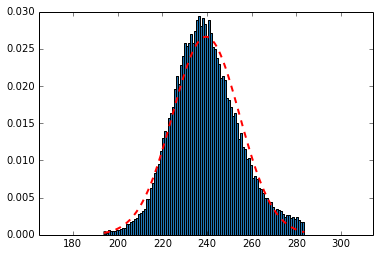

In [57]:
def clip(data, sigma=3):
    """Remove all values above a threshold from the array.
    Uses iterative clipping at sigma value until nothing more is getting clipped.
    Args:
        data: a numpy array
    """
    raveled = data.ravel()
    median = np.median(raveled)
    std = np.std(raveled)
    newdata = raveled[np.abs(raveled-median) <= sigma*std]
    if len(newdata) and len(newdata) != len(raveled):
        return clip(newdata, sigma)
    else:
        return newdata




(mu, sigma) = norm.fit(clip(source_df.f_int))
n, bins, patches   =  plt.hist(clip(source_df.f_int),
                               bins=100,normed=1,facecolor="#1f77b4")
y = mlab.normpdf(bins, mu, sigma)

print "Gaus fit: mu {}, sigma {}".format(round(mu,3),round(sigma,3))

l = plt.plot(bins,y,'r--', linewidth=2)
plt.xlim([mu-5*sigma,mu+5*sigma])

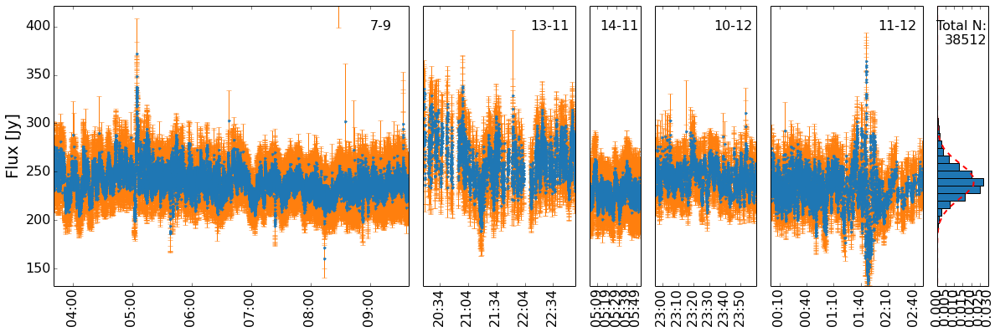

In [16]:
x = plot_lightcurve(data,73,stdout=False)

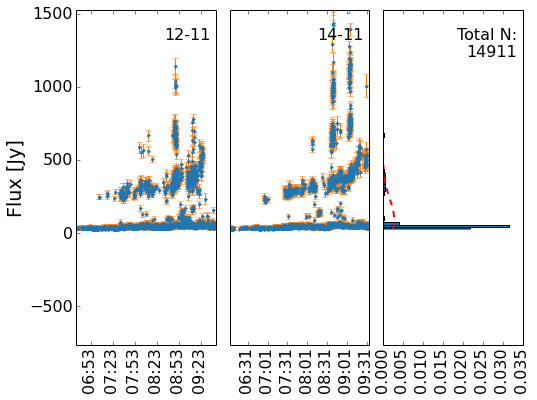

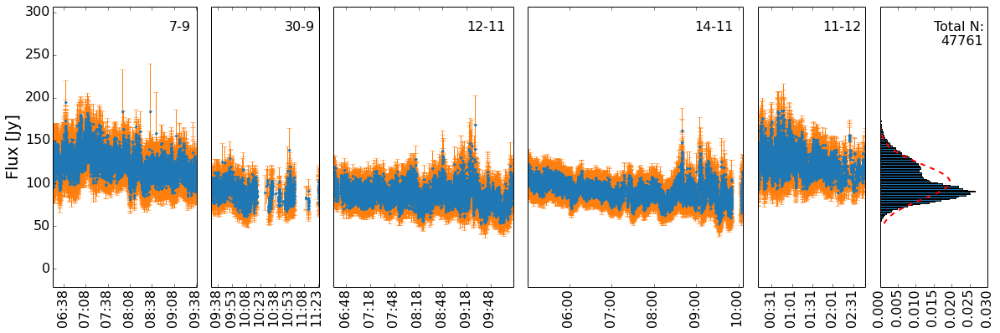

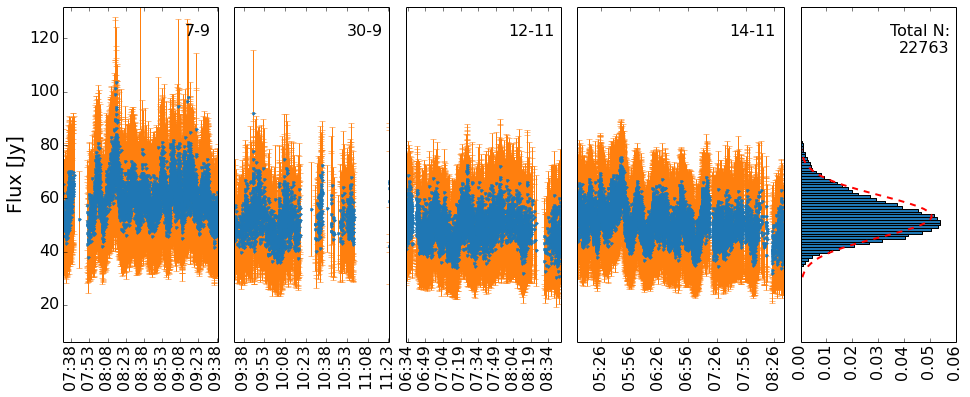

In [41]:
x = plot_lightcurve(data,72,stdout=False)
x = plot_lightcurve(data,41,stdout=False)
x = plot_lightcurve(data,142,stdout=False)
# x = plot_lightcurve(data,54,stdout=False)
# x = plot_lightcurve(data,158,stdout=False)

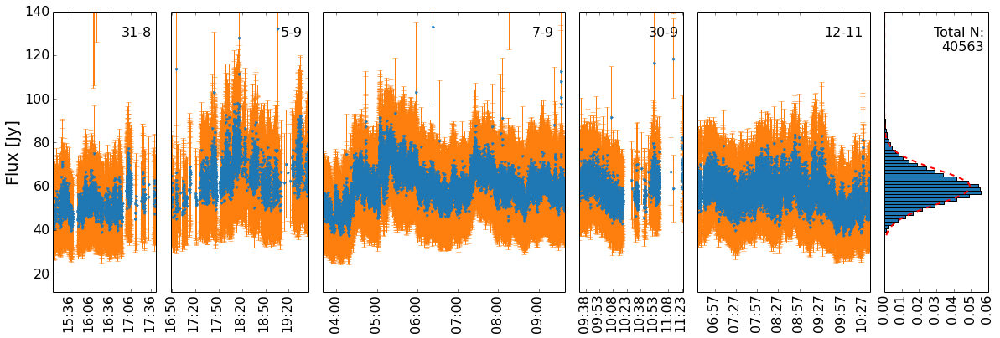

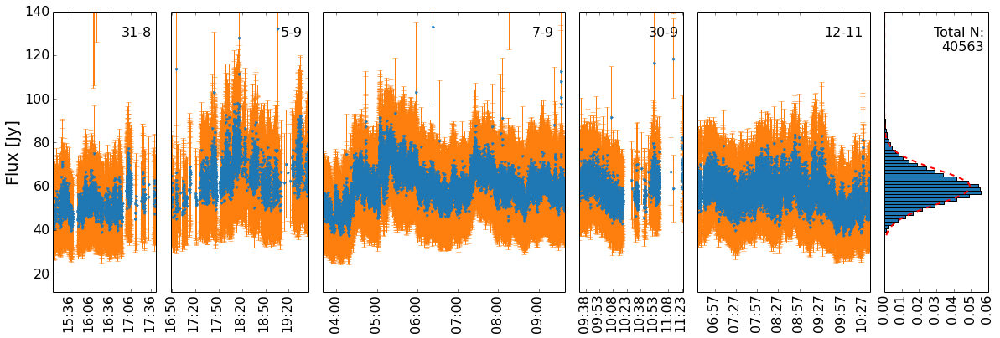

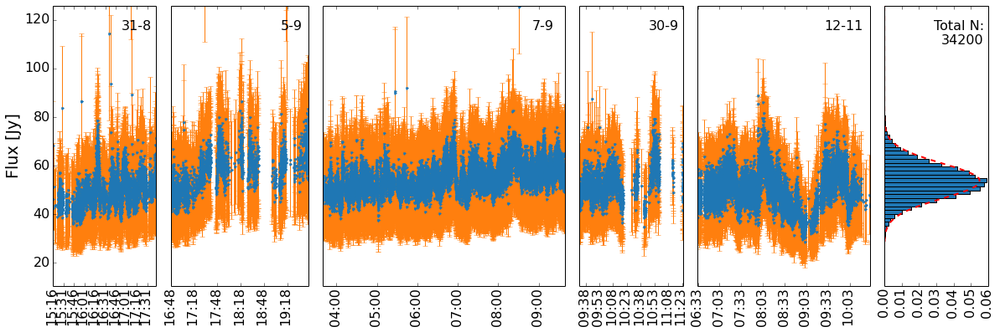

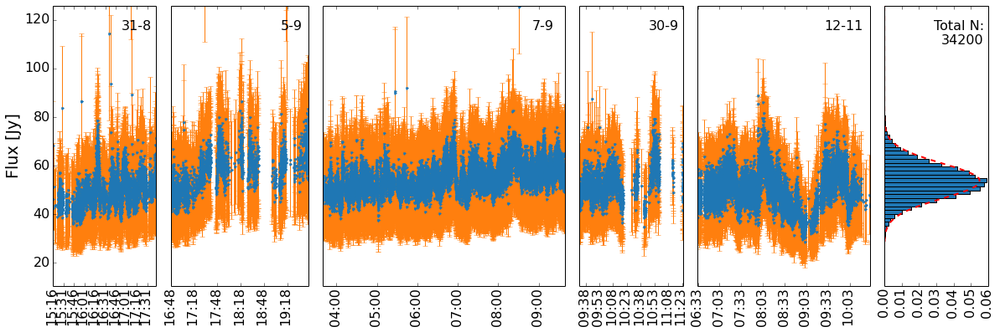

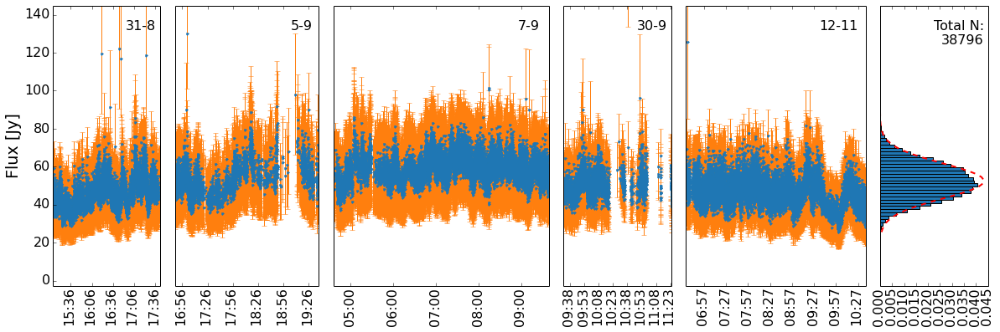

...

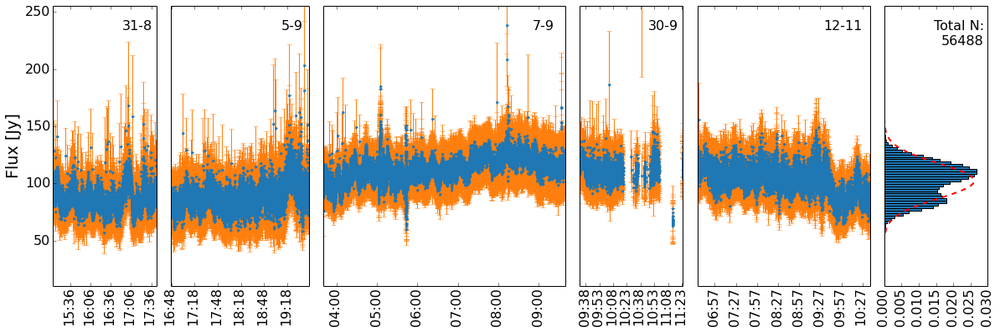

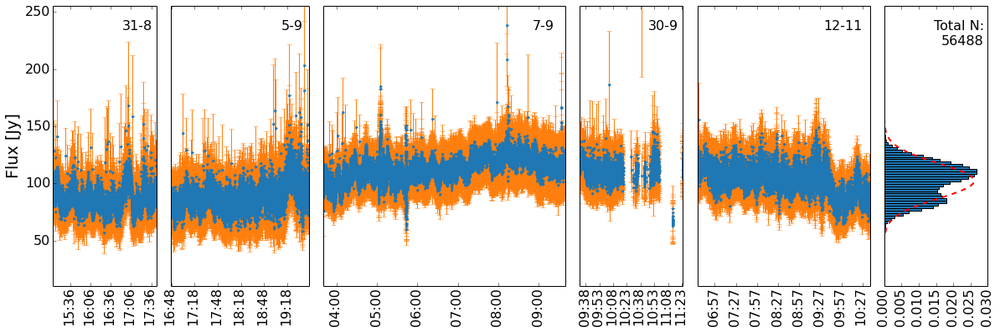

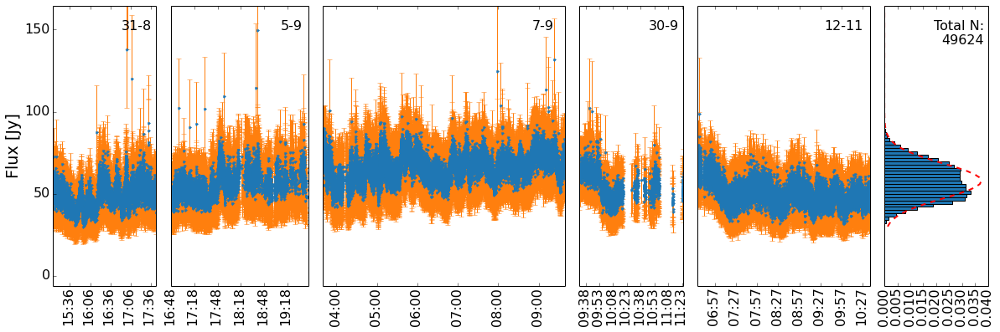

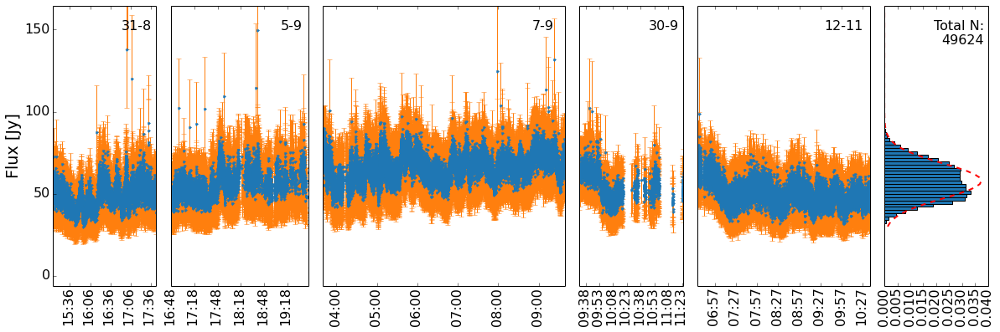

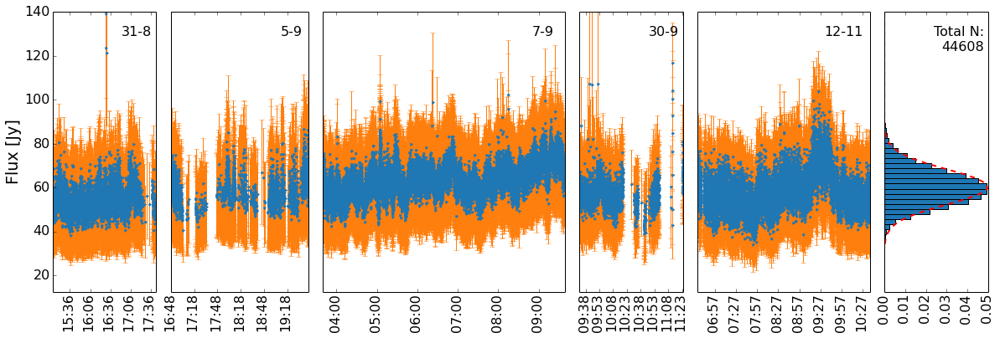

ERROR:tornado.general:Uncaught exception, closing connection.
Traceback (most recent call last):
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 414, in _run_callback
    callback(*args, **kwargs)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/tornado/stack_context.py", line 277, in null_wrapper
    return fn(*args, **kwargs)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 283, in dispatcher
    return self.dispatch_shell(stream, msg)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 235, in dispatch_shell
    handler(stream, idents, msg)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 399, in execute_request
    user_expressions, allow_stdin)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/ipkernel.py", line 196, in do_execute
    res = sh

In [ ]:
for i in np.unique(data.runcatid):
#     print i, len(np.unique(data[data.runcatid == i].dataset))
    if len(np.unique(data[data.runcatid == i].dataset)) == 5:    
        plot_lightcurve(data,i,stdout=False)
        plot_lightcurve(new_data,i,stdout=False)
# plt.show()

#### Save Catalogue

In [13]:
new_corrected.to_csv("fbflux_avg_corrected_lightcurves.csv")

#### Load catalogue

In [15]:
data = pd.read_csv("fbflux_avg_corrected_lightcurves.csv")

# Operations on Corrected catalogue

In [16]:
new_corrected

,taustart_ts,dataset,decl,decl_err,eta_int,f_int,f_int_err,freq_eff,ra,ra_err,runcatid,v_int,wm_decl,wm_ra
0,2016-09-05 19:08:47.687,2,26.861110,0.117658,0.000000,163.354872,32.393567,60058593.75,355.044069,0.107165,0,0.000000,26.891016,355.024474
1,2016-09-05 19:08:55.740,2,26.847360,0.116299,0.008864,159.124817,31.135614,60058593.75,355.027893,0.105992,0,0.020348,26.891016,355.024474
2,2016-09-05 19:08:57.753,2,26.846424,0.112301,0.004629,161.910952,30.628569,60058593.75,355.051894,0.102322,0,0.014605,26.891016,355.024474
3,2016-09-05 19:09:18.893,2,26.821810,0.123001,0.014072,168.593526,35.123919,60058593.75,355.054810,0.112199,0,0.026669,26.891016,355.024474
4,2016-09-05 19:09:20.906,2,26.829443,0.118824,0.012582,166.266121,33.404700,60058593.75,355.085495,0.108357,0,0.024711,26.891016,355.024474
5,2016-09-05 19:09:22.919,2,26.855524,0.115272,0.010310,164.788279,32.154609,60058593.75,355.029186,0.105229,0,0.022227,26.891016,355.024474
6,2016-09-05 19:09:24.932,2,26.829363,0.114336,0.013741,157.938562,30.389607,60058593.75,355.086379,0.104284,0,0.025569,26.891016,355.024474
7,2016-09-05 19:09:26.946,2,26.821467,0.110790,0.037107,177.859922,33.556211,60058593.75,355.047978,0.101110,0,0.041699,26.891016,355.024474
8,2016-09-05 19:09:28.959,2,26.806481,0.122694,0.032670,166.028355,34.443824,60058593.75,355.094361,0.111912,0,0.039045,26.891016,355.024474
9,2016-09-05 19:09:29.965,2,26.774060,0.115804,0.063822,186.196278,36.838132,60058593.75,355.047855,0.105677,0,0.056752,26.891016,355.024474


213.17954510693298 52.1877905532195
2016-08-31T15:10:14.774000000
2016-09-05T16:47:14.725000000
2016-09-07T07:11:32.317000000


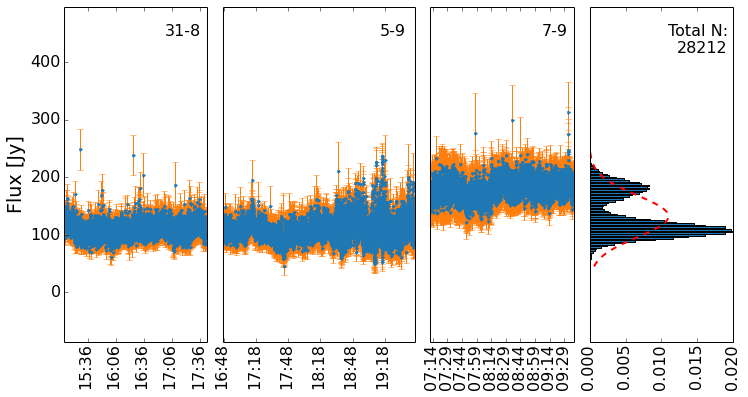

In [13]:
plot_1 = plot_lightcurve(data, 2)

In [65]:
for i in np.unique(new_corrected.runcatid):
    print i,'\t',len(new_corrected[new_corrected == i])

0 	5246544
1 	5246544
2 	5246544
3 	5246544
4 	5246544
5 	5246544
6 	

KeyboardInterrupt: 

In [25]:
ref_cat = ref_cat[]

,N,f_int,f_int_err,wm_decl,wm_ra
0,1.0,32.780000,0.960000,-36.493308,23.490571
1,26360.0,79.155487,58.851492,33.285828,24.832559
2,1.0,1038.200000,23.020000,-37.208200,50.674121
3,98191.0,444.619278,118.197647,29.752959,69.670432
4,1.0,77.400000,3.230000,-28.165114,71.157112
5,1.0,25.920000,2.550000,16.639410,80.291186
6,1.0,548.910000,13.630000,-45.778848,79.957179
7,27270.0,42.493655,52.063286,49.821258,86.081323
8,60197.0,157.428682,61.433584,48.186026,123.859452
9,1.0,734.090000,5.050000,-12.095553,139.523546


1.0

In [84]:
len(bootstrap[(bootstrap.runcatid == 2)].values)

2490

In [93]:
for i in np.unique(bootstrap.runcatid):
    source_fdf = retrieve_source(bootstrap, i)
    print len(source_fdf.f_int), len(source_fdf[np.isfinite(source_fdf.f_int)])

2490 2490
2704 2704
2701 2701
2642 2642
2690 2690
2663 2663
2705 2705
2704 2704
2668 2668
2705 2705
2663 2663
2578 2578
2703 2703
2671 2671
2661 2661
2648 2648
2703 2703
2104 2104
2558 2558
2093 2093
1862 1862
2633 2633
2697 2697
2597 2597
2705 2705
2704 2704
2702 2702
2678 2678
2667 2667
1919 1919
2210 2210
2171 2171
1969 1969
2704 2704
2153 2153
2518 2518
2181 2181
1958 1958
2428 2428
2621 2621
1887 1887
2704 2704
1989 1989
2681 2681


In [95]:
new_corrected.f

,taustart_ts,dataset,eta_int,f_int,f_int_err,freq_eff,runcatid,v_int,wm_decl,wm_ra
0,2016-09-07 05:42:50.248,9,0.000000,128.820137,154.397323,60058593.75,0,0.000000,62.823021,0.318647
1,2016-09-07 05:43:01.321,9,0.302655,118.751345,144.498178,60058593.75,0,0.247751,62.823021,0.318647
2,2016-09-07 05:43:16.421,9,0.241808,119.520648,148.978718,60058593.75,0,0.226510,62.823021,0.318647
3,2016-09-07 05:43:24.474,9,0.231040,115.382434,139.771426,60058593.75,0,0.227347,62.823021,0.318647
4,2016-09-07 05:44:09.772,9,0.194505,86.855922,110.723057,60058593.75,0,0.212352,62.823021,0.318647
5,2016-09-07 05:44:11.786,9,0.190529,87.930346,112.469352,60058593.75,0,0.209254,62.823021,0.318647
6,2016-09-07 05:51:37.724,9,0.169032,95.515760,121.448744,60058593.75,0,0.196955,62.823021,0.318647
7,2016-09-07 05:53:48.586,9,0.162823,103.244235,127.862105,60058593.75,0,0.195432,62.823021,0.318647
8,2016-09-07 05:54:33.885,9,0.146707,100.541605,124.722874,60058593.75,0,0.184850,62.823021,0.318647
9,2016-09-07 05:54:52.004,9,0.138382,100.203117,125.296785,60058593.75,0,0.178208,62.823021,0.318647


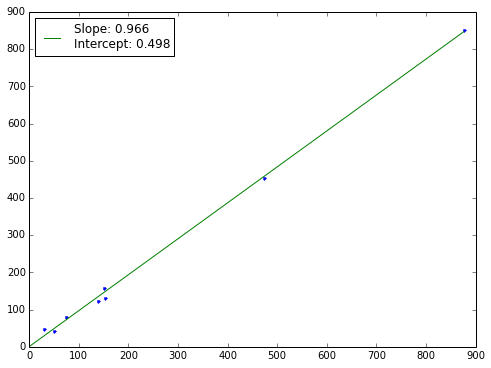

In [42]:
perley =  pd.read_csv("/scratch/mkuiack/perley_fluxes_update.csv")
ref_cat = pd.read_csv("simple_AARTFAAC_beam-reference.csv")
ref_cat = ref_cat[(ref_cat.N > 1)]

def distSquared(p0, p1):
    distance  = np.sqrt((p0[0] - p1[0,:])**2 + (p0[1] - p1[1,:])**2)
    if len(np.where(distance < 1.0)[0]) > 0:
        return np.where(distance <1.0)[0]
    else:
        return None
    
# data_set = [5,7,1,2,9,3,6,4]

# _source = "3C48"
_dataset = 1
set_AART = []
set_perl = []

for _source in perley.Source[(perley.dec > 2)]:

    data_index = distSquared((perley[perley.Source == _source].ra.values,
                              perley[perley.Source == _source].dec.values),
                             np.array([ref_cat.ra, ref_cat.dec]))
    
    if type(data_index) == np.ndarray:
#             plt.figure()
#             plt.title(_source)
#             plt.plot(pd.to_datetime(tmp_data.taustart_ts.iloc[data_index]), tmp_data.f_int.iloc[data_index], ".")
#             plt.xticks(rotation=-20)
        set_perl.append(np.float(perley[perley.Source == _source].int_flux.values))
        set_AART.append(np.median(ref_cat.f_int.iloc[data_index]))
plt.figure(figsize=(8,6))
# plt.title(str(i)+" "+str(len(set_AART)))
plt.plot(set_perl,set_AART,".")

fit = np.polyfit(set_perl,set_AART,1)

plt.plot(np.linspace(0,np.max(set_perl)),
         fit[1]+np.linspace(0,np.max(set_perl))*fit[0],
         label="Slope: {}\nIntercept: {}".format(round(fit[0],3), round(fit[1],3)))
plt.legend(loc="upper left")

(0, 1000)

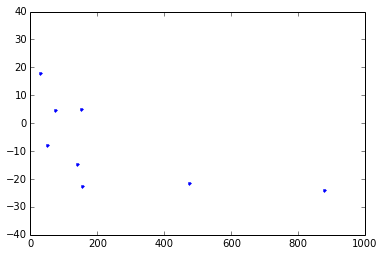

In [47]:
plt.plot(set_perl,np.array(set_AART)-np.array(set_perl),".")
plt.ylim([-40,40])
plt.xlim([0,1000])

In [49]:
print np.array(set_AART)-np.array(set_perl)
print set_perl

[  4.8430451  -21.30680982  -7.79625803   5.18751595  18.11102238
 -14.56943811 -23.88708227 -22.6582821 ]
[74.51, 473.84, 50.5604, 151.81, 29.14, 138.66, 876.45, 152.66]


In [50]:
ref_cat = pd.read_csv("simple_AARTFAAC_beam-reference.csv")
ref_cat

,Unnamed: 0,N,f_int,f_int_err,dec,ra
0,1,26360,79.353045,58.642905,33.285828,24.832559
1,3,33764,452.533190,114.596661,29.734487,69.668029
2,7,27270,42.764142,51.817375,49.821258,86.081323
3,8,60197,156.997516,61.176818,48.186026,123.859452
4,10,21904,47.251022,55.278973,30.530245,203.023910
5,11,78043,124.090562,57.309469,52.145059,213.161911
6,12,23174,852.562918,256.593339,5.019247,253.115735
7,14,62244,130.001718,66.361681,48.749511,277.648686
8,16,56686,87.229410,75.286399,60.891436,319.772782
9,17,45402,42.483201,50.807931,64.358691,207.783497


('ref mathces', 38)
('ref mathces', 35)
('ref mathces', 30)
('ref mathces', 22)
('ref mathces', 50)
('ref mathces', 20)
('ref mathces', 42)
('ref mathces', 24)


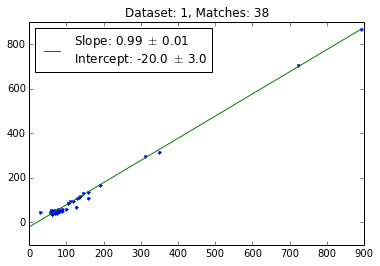

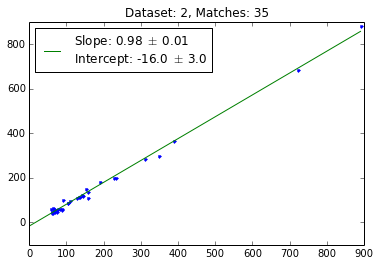

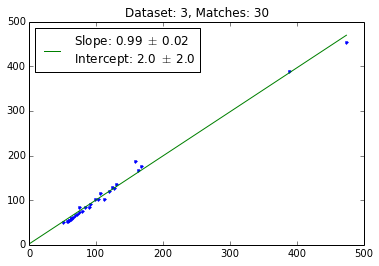

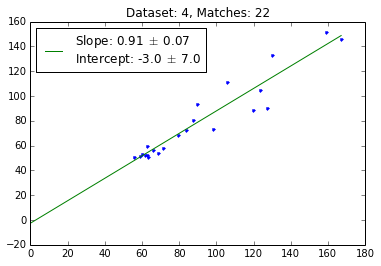

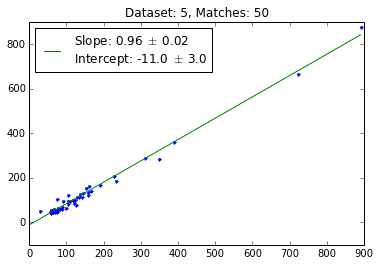

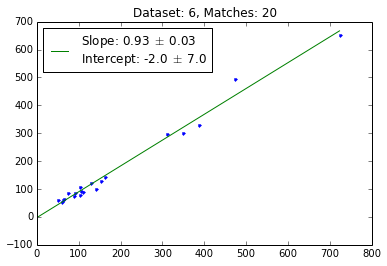

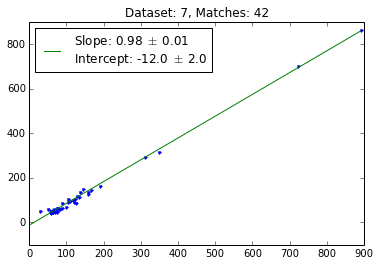

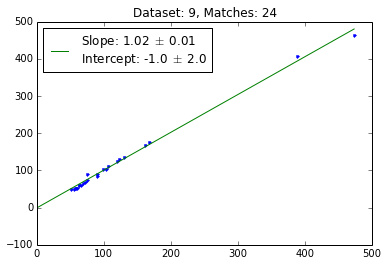

In [29]:
def distSquared(p0, p1):
    distance  = np.sqrt((p0[0] - p1[0,:])**2 + (p0[1] - p1[1,:])**2)
    if len(np.where(distance < 1.0)[0]) > 0:
        return np.where(distance < 1.0)[0]
    else:
        return None
    

# perley =  pd.read_csv("/scratch/mkuiack/perley_fluxes_update.csv")
# ref_cat = pd.DataFrame({'wm_ra':perley.ra,'wm_decl':perley.dec,
#                         'f_int':perley.int_flux,'f_int_err':perley.int_flux_err,
#                         "N":np.ones(len(perley.int_flux))})

perley =  pd.read_csv("/scratch/mkuiack/simple_AARTFAAC_flux-reference.csv")
ref_cat = pd.DataFrame({'wm_ra':perley.wm_ra,'wm_decl':perley.wm_decl,
                        'f_int':perley.f_int,'f_int_err':perley.f_int_err,
                        "N":np.ones(len(perley.f_int))})

for i in np.unique(data.dataset):

    set_AART = []
    set_perl = [] 
    tmp_data = data[(data.dataset == i)]


    for _runcat in np.unique(tmp_data.runcatid):

        src = tmp_data[(tmp_data.runcatid == _runcat)].median(axis=0)

        src_x, src_y = pol2cart(np.abs(90-src.wm_decl),
            np.deg2rad(src.wm_ra))

        ref_x, ref_y = pol2cart(np.abs(90-ref_cat.wm_decl),
            np.deg2rad(ref_cat.wm_ra))

        data_index = distSquared(np.array([src_x,src_y]),
               np.array([ref_x, ref_y]))


        if type(data_index) == np.ndarray:
            data_index = data_index[0]
#             print ref_cat.wm_ra.iloc[data_index], ref_cat.wm_decl.iloc[data_index]
            
#             print ref_cat.f_int.iloc[data_index]
            
            set_perl.append(np.float(np.nanmean(ref_cat.f_int.iloc[data_index])))
            set_AART.append(src.f_int)

    print("ref mathces",len(set_perl))
    if len(set_perl) == 0:
        continue
    
    plt.figure()
    plt.title("Dataset: "+str(i)+", Matches: "+str(len(set_AART)))
    plt.plot(set_perl,set_AART,".")
    if len(set_perl) > 4:
        fit,cov = np.polyfit(set_perl,set_AART,1,cov=True)

#     corrected_data.f_int[(corrected_data.dataset == i)] = (corrected_data.f_int[(corrected_data.dataset == i)]-fit[1])/fit[0]
        plt.plot(np.linspace(0,np.max(set_perl)),
             fit[1]+np.linspace(0,np.max(set_perl))*fit[0],
             label=r"Slope: {} $\pm$ {} " "\n" r"Intercept: {} $\pm$ {}".format(np.around(fit[0],int(-(np.floor(np.log10(nsf(np.sqrt(cov[0,0]))))))),
                                                                        nsf(np.sqrt(cov[0,0])),
                                                                        np.around(fit[1],int(-(np.floor(np.log10(nsf(np.sqrt(cov[1,1]))))))),
                                                                        nsf(np.sqrt(cov[1,1]))))
    else:
        fit = np.polyfit(set_perl,set_AART,1)
        plt.plot(np.linspace(0,np.max(set_perl)),
             fit[1]+np.linspace(0,np.max(set_perl))*fit[0],
             label="Slope: {} \n Intercept: {} ".format(round(fit[0],2), round(fit[1],2)))

    plt.legend(loc="upper left")

In [41]:
ref_cat.f_int.iloc[data_index]

18    129.879802
63    130.810547
Name: f_int, dtype: float64

In [152]:
ref_cat

,N,f_int,f_int_err,wm_decl,wm_ra
0,1.0,32.780000,0.960000,-36.493308,23.490571
1,1.0,74.510000,0.650000,33.159756,24.422071
2,1.0,1038.200000,23.020000,-37.208200,50.674121
3,1.0,473.840000,3.870000,29.670505,69.268230
4,1.0,77.400000,3.230000,-28.165114,71.157112
5,1.0,25.920000,2.550000,16.639410,80.291186
6,1.0,548.910000,13.630000,-45.778848,79.957179
7,1.0,50.560400,0.650000,49.851968,85.651103
8,1.0,167.025229,16.872055,48.150219,123.872230
9,1.0,734.090000,5.050000,-12.095553,139.523546


In [46]:
fit = np.polyfit(set_perl,set_AART,1)

In [51]:
fit, cov = np.polyfit(set_perl,set_AART,1, cov=True)

In [50]:
round(fit[0],3)

0.922

In [55]:
x = cov[0,0]

In [64]:
print x.nonzero


<built-in method nonzero of numpy.float64 object at 0x7f3955ea7f00>


In [59]:
x

0.004760420806161405

In [76]:
def nsf(num, n=1):
    """n-Significant Figures"""
    numstr = ("{0:.%ie}" % (n-1)).format(num)
    return float(numstr)

nsf(x)

0.005

In [75]:
print nsf(cov[0,0])
print nsf(cov[0,1])
print nsf(cov[1,0])
print nsf(cov[1,1])

0.0048
-0.45
-0.45
48.0


In [73]:
cov

array([[ 4.76042081e-03, -4.46134218e-01],
       [-4.46134218e-01,  4.79401220e+01]])

In [78]:
np.frexp(10)

(0.625, 4)

In [89]:
print round(fit[0],2), nsf(np.sqrt(cov[0,0]))
print round(fit[1],2), nsf(np.sqrt(cov[1,1]))

0.92 0.07
-7.36 7.0


In [116]:
print round(fit[1],int(np.floor(np.log10(nsf(np.sqrt(cov[1,1])))))), nsf(np.sqrt(cov[1,1]))
print round(fit[0],int(np.abs(np.floor(np.log10(nsf(np.sqrt(cov[0,0]))))))), nsf(np.sqrt(cov[0,0]))

-7.0 7.0
0.92 0.07


In [98]:
np.floor(np.log10(nsf(np.sqrt(cov[1,1]))))

0.0

In [131]:
print np.around(fit[0],int(-(np.floor(np.log10(nsf(np.sqrt(cov[0,0]))))))), nsf(np.sqrt(cov[0,0]))
print np.around(fit[i],int(-(np.floor(np.log10(nsf(np.sqrt(cov[i,i]))))))), nsf(np.sqrt(cov[i,i]))

0.92 0.07
-7.0 7.0


In [121]:
np.sqrt(10000.)

31.622776601683793

In [125]:
np.around(1234,-1)

1230

In [140]:
def nsf(num, n=1):
    """n-Significant Figures"""
    numstr = ("{0:.%ie}" % (n-1)).format(num)
    return float(numstr)

def num_err(num, err, n=1):
    '''Return number rounded based on error'''
    return np.around(num,int(-(np.floor(np.log10(nsf(err,n=n)))))), nsf(err,n=n)

In [130]:
source_df = retrieve_source(data,0)
n,edges = np.histogram(clip(source_df.f_int),bins=100, normed=True)


(mu, sigma) = norm.fit(clip(source_df.f_int))

fit,cov = scipy.optimize.curve_fit(skewnorm,edges[1:],n,p0=(mu,sigma,1.0))


In [136]:
print fit[0]+skew_mode(0, 0, fit[2]) * fit[1]


37.007213533544935
32.03638071405839


In [150]:
def distSquared(p0, p1):
    distance  = np.sqrt((p0[0] - p1[0,:])**2 + (p0[1] - p1[1,:])**2)
    if len(np.where(distance < 1.0)[0]) > 0:
        return np.where(distance < 1.0)[0]
    else:
        return None

cal_flux = []
cal_err = []
cal_sem = []
perley_flux = []
perley_err = []

for i in np.unique(data.runcatid):
    _ra = np.mean(data[data.runcatid == i].wm_ra)
    _dec = np.mean(data[data.runcatid == i].wm_decl)
    
    src_x, src_y = pol2cart(np.abs(90-_dec),
        np.deg2rad(_ra))

    ref_x, ref_y = pol2cart(np.abs(90-perley.dec.values ),
        np.deg2rad(perley.ra.values))

    data_index = distSquared(np.array([src_x,src_y]),
           np.array([ref_x, ref_y]))    
    
    if type(data_index) == np.ndarray:
        data_index = int(data_index)
#         print _ra,_dec, '\t', perley.ra.iloc[data_index].values, perley.dec.iloc[data_index].values
#         print np.mean(data[data.runcatid == i].f_int), '\t', perley.int_flux.iloc[data_index].values

        
#         n,edges = np.histogram(clip(data[data.runcatid == i].f_int),bins=100, normed=True)
#         (mu, sigma) = norm.fit(clip(data[data.runcatid == i].f_int))
        
#         fit,cov = scipy.optimize.curve_fit(skewnorm,edges[1:],n,p0=(mu,sigma,1.0))
#         flux_mode = fit[0]+skew_mode(0, 0, fit[2]) * fit[1]
#         cal_flux.append(flux_mode)
        
        cal_flux.append(np.mean(data[data.runcatid == i].f_int))

        cal_err.append(np.mean(data[data.runcatid == i].f_int_err))
        cal_sem.append(sem(data[data.runcatid == i].f_int))
        perley_flux.append(perley.int_flux.iloc[data_index])
        perley_err.append(perley.int_flux_err.iloc[data_index])  

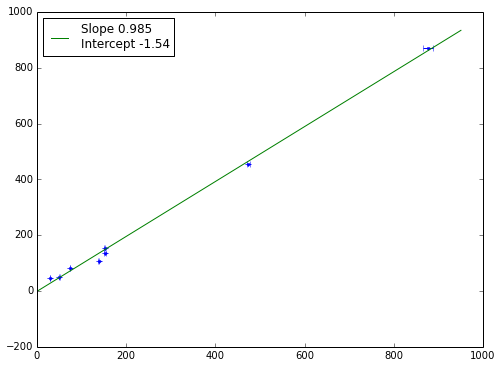

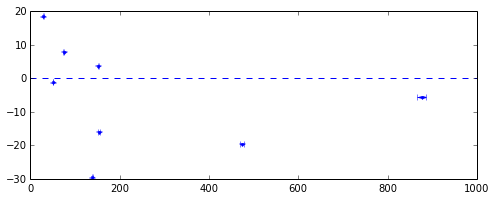

In [147]:
plt.figure(figsize=(8,6))
plt.errorbar(perley_flux,cal_flux,yerr=cal_sem,xerr=perley_err,fmt=".")
fit = np.polyfit(perley_flux,cal_flux,1)
plt.plot(np.linspace(0,950), fit[0]*np.linspace(0,950)+fit[1], label="Slope {} ""\n""Intercept {}".format(round(fit[0],3), round(fit[1],3)))
plt.legend()
# plt.plot(np.linspace(0,950),np.linspace(0,950),"--",c="blue")

plt.figure(figsize=(8,3))
yerr = np.array(cal_sem)#+np.array(perley_err)
plt.errorbar(perley_flux,np.array(cal_flux) - np.array(perley_flux),xerr=perley_err,yerr=yerr,fmt=".")

# plt.plot(np.linspace(0,950), fit[0]*np.linspace(0,950)+fit[1], label="Slope {} ""\n""Intercept {}".format(round(fit[0],3), round(fit[1],3)))

plt.plot(np.linspace(0,1000),np.linspace(0,0),"--",c="blue")
# plt.ylim(-25,25)
# plt.xlim(0,1000)

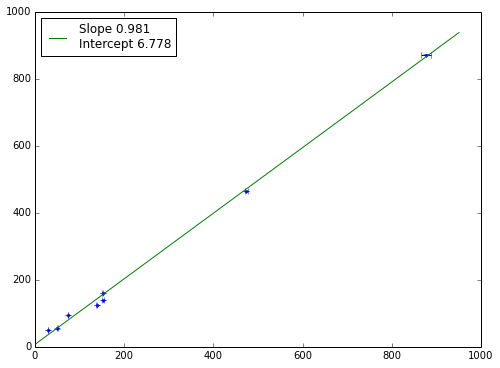

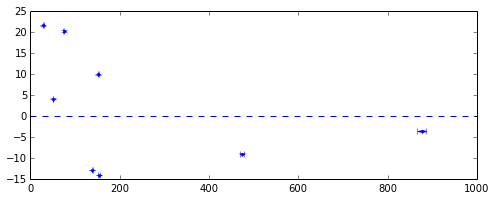

In [151]:
plt.figure(figsize=(8,6))
plt.errorbar(perley_flux,cal_flux,yerr=cal_sem,xerr=perley_err,fmt=".")
fit = np.polyfit(perley_flux,cal_flux,1)
plt.plot(np.linspace(0,950), fit[0]*np.linspace(0,950)+fit[1], label="Slope {} ""\n""Intercept {}".format(round(fit[0],3), round(fit[1],3)))
plt.legend()
# plt.plot(np.linspace(0,950),np.linspace(0,950),"--",c="blue")

plt.figure(figsize=(8,3))
yerr = np.array(cal_sem)#+np.array(perley_err)
plt.errorbar(perley_flux,np.array(cal_flux) - np.array(perley_flux),xerr=perley_err,yerr=yerr,fmt=".")

# plt.plot(np.linspace(0,950), fit[0]*np.linspace(0,950)+fit[1], label="Slope {} ""\n""Intercept {}".format(round(fit[0],3), round(fit[1],3)))

plt.plot(np.linspace(0,1000),np.linspace(0,0),"--",c="blue")
# plt.ylim(-25,25)
# plt.xlim(0,1000)

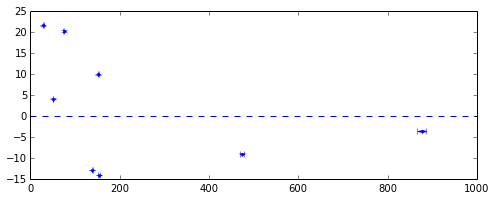

In [141]:
plt.figure(figsize=(8,3))
yerr = np.array(cal_sem)#+np.array(perley_err)
plt.errorbar(perley_flux,np.array(cal_flux) - np.array(perley_flux),xerr=perley_err,yerr=yerr,fmt=".")

# plt.plot(np.linspace(0,950), fit[0]*np.linspace(0,950)+fit[1], label="Slope {} ""\n""Intercept {}".format(round(fit[0],3), round(fit[1],3)))

plt.plot(np.linspace(0,1000),np.linspace(0,0),"--",c="blue")
# plt.ylim(-25,25)
# plt.xlim(0,1000)

In [36]:
for i in range(len(cal_flux)):
    print cal_flux[i], perley_flux[i], cal_flux[i] - perley_flux[i]

464.7787847916293 473.84 -9.061215208370697
872.9626359453789 876.45 -3.487364054621139
54.69919483810635 50.5604 4.1387948381063495
161.79052105975762 151.81 9.98052105975762
94.8658479648992 74.51 20.355847964899198
125.73276175453225 138.66 -12.927238245467748
50.789836843248494 29.14 21.649836843248494
138.61307173529883 152.66 -14.046928264701165


In [15]:
# Mean repeated timestamps
for ID in np.unique(data.runcatid):
#     print ID
    source_df = data[data.runcatid == ID]
    pd.to_datetime(source_df.taustart_ts)
    source_df = source_df.groupby('taustart_ts', as_index=False).mean()
    source_df.set_index(source_df.taustart_ts, inplace=True)

    if ID != 0:
        new_corrected = pd.concat([new_corrected,source_df], ignore_index=True)
    else:
        new_corrected = source_df.copy(deep=True)


In [18]:
print data.shape
new_corrected.shape
print data.shape

del new_corrected

(6580484, 12)


NameError: name 'new_corrected' is not defined

## Make reference catalogue

In [39]:
def gauss(x,mu,sigma,A):
    return A*exp(-(x-mu)**2./2./sigma**2.)

def make_refcat(data):
    ra = []
    dec = [] 
    flux = [] 
    flux_err = [] 
    N = []
    runcat = []
    skew_norm = []
    
    

    for i in np.unique(data.runcatid):
        ra.append(np.mean(data[(data.runcatid == i) & (np.isfinite(data.f_int))].wm_ra))
        dec.append(np.mean(data[(data.runcatid == i) & (np.isfinite(data.f_int))].wm_decl))

        fluxes = data[(data.runcatid == i) & (np.isfinite(data.f_int))].f_int        
        n, bins  =  np.histogram(clip(fluxes),
                                          bins=100,normed=1)
        n_measures = len(data[(data.runcatid == i) & (np.isfinite(data.f_int))].values)

        (mu, sigma) = norm.fit(clip(fluxes))
        
        fit,cov = scipy.optimize.curve_fit(skewnorm,bins[1:],n,p0=(mu,sigma,1.0))
        
        if ((fit[2] - np.sqrt(cov[2,2])) < 0.0) and ((fit[2] + np.sqrt(cov[2,2])) > 0.0):
            fit,cov = scipy.optimize.curve_fit(gauss, bins[1:],n,p0=(mu,sigma,1.0))
            
            
            flux.append(fit[0])
            flux_err.append(cov[0,0])
            N.append(n_measures)
            runcat.append(i)
            skew_norm.append("N")
            continue 
            
#         tmp_modes.append(sk_mode(fit[0],fit[1],fit[2]))
#         mode_ranges.append(delta_sk_mode(np.sqrt(cov[0,0]),
#                                         fit[1],np.sqrt(cov[1,1]),
#                                         fit[2],np.sqrt(cov[2,2])))

        flux.append(sk_mode(fit[0],fit[1],fit[2]))
        flux_err.append(delta_sk_mode(np.sqrt(cov[0,0]),
                                        fit[1],np.sqrt(cov[1,1]),
                                        fit[2],np.sqrt(cov[2,2])))

        
#         flux.append(np.median(data[(data.runcatid == i) & (np.isfinite(data.f_int))].f_int))
#         flux_err.append(np.median(data[(data.runcatid == i) & (np.isfinite(data.f_int))].f_int_err))

        N.append(n_measures)
        runcat.append(i)
        skew_norm.append("S")



    return pd.DataFrame({'ra':ra,'decl':dec,
                            'f_int':flux,'f_int_err':flux_err,
                            "N":N, "runcatid":runcat,"fit_type":skew_norm })




In [40]:
ref_cat = make_refcat(data)

In [41]:
ref_cat.to_csv("FINAL_flux_ref.csv")

In [58]:
np.arange(0,100,10)

array([ 0, 10, 20, 30, 40, 50, 60, 70, 80, 90])

In [18]:
ref_cat[ref_cat.fit_type =="N"]

,N,decl,f_int,f_int_err,fit_type,ra,runcatid
39,51413,76.884329,49.758538,0.009418,N,221.394807,40
70,22752,22.504557,49.547729,0.017798,N,151.458386,72
133,67908,45.591956,116.487473,0.563921,N,140.741457,137


52.4303977721573 55.4204029220424
2016-09-07T03:40:15.736000000
2016-11-12T17:17:49.854000000
2016-11-13T20:00:10.543000000
2016-12-10T22:55:10.560000000
2016-12-11T00:00:00.190000000
Gaus fit: mu 86.448, sigma 9.555


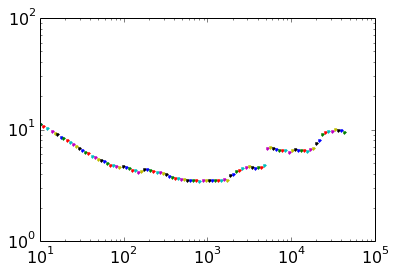

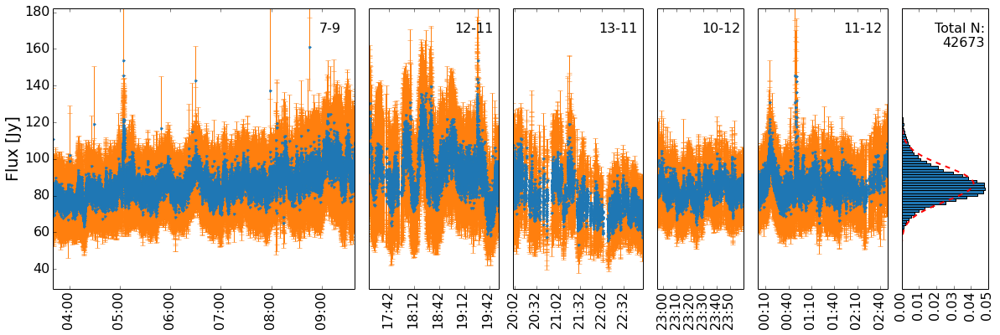

In [71]:
source_df = retrieve_source(new_corrected,2)

for i in np.logspace(1,np.log10(len(source_df.f_int)),100, dtype=int):
    plt.plot(i,np.nanstd(source_df.f_int.values[:i]),".")
    
plt.xscale("log")
plt.yscale("log")

p = plot_lightcurve(new_corrected,2)

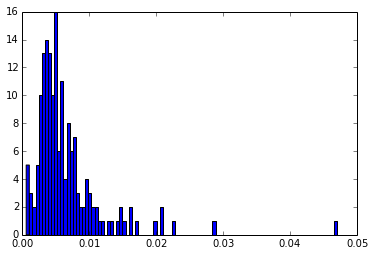

In [46]:
h = plt.hist(ref_cat.f_int_err/ref_cat.f_int, bins =100)

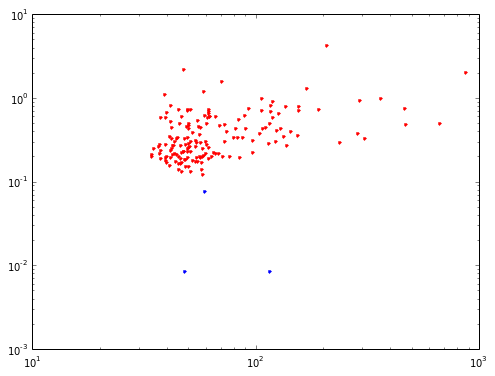

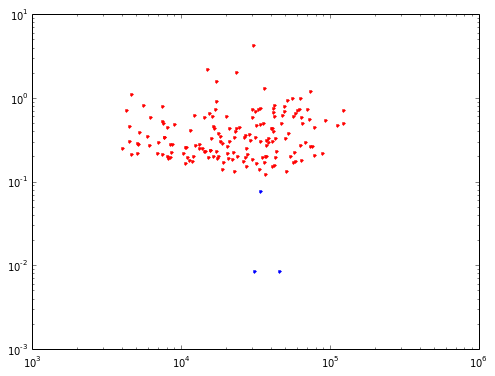

In [49]:
plt.figure(figsize=(8,6))
plt.plot(ref_cat[ref_cat.fit_type == "S"].f_int,
         ref_cat[ref_cat.fit_type == "S"].f_int_err,".",c="red")

plt.plot(ref_cat[ref_cat.fit_type == "N"].f_int,
         ref_cat[ref_cat.fit_type == "N"].f_int_err,".",c="blue")

plt.xscale("log")
plt.xlabel("Integrated Flux")
plt.yscale("log")
plt.xlabel("Integrated Flux Error")

plt.figure(figsize=(8,6))
plt.plot(ref_cat[ref_cat.fit_type == "S"].N,
         ref_cat[ref_cat.fit_type == "S"].f_int_err,".",c="red")

plt.plot(ref_cat[ref_cat.fit_type == "N"].N,
         ref_cat[ref_cat.fit_type == "N"].f_int_err,".",c="blue")

plt.xscale("log")
plt.yscale("log")
plt.xlabel("Integrated Flux Error")


# STD of means

In [55]:
np.arange(,160,10)

array([  4,  14,  24,  34,  44,  54,  64,  74,  84,  94, 104, 114, 124,
       134, 144, 154])

In [83]:
def std_of_means(lightcurve):
    curvelength = []
    std_means = []
    
    for n in np.arange(4,len(lightcurve)/100,10):
        tmp_mean = []
        for i in range(n):
            new_index = len(lightcurve)*np.linspace(0,1,n+1)
            a = np.int(new_index[i])
            b = np.int(new_index[i+1])
            tmp_mean.append(np.nanmean(lightcurve[a:b]))

        curvelength.append((b-a))
        std_means.append(np.var(tmp_mean))
    return std_means, curvelength

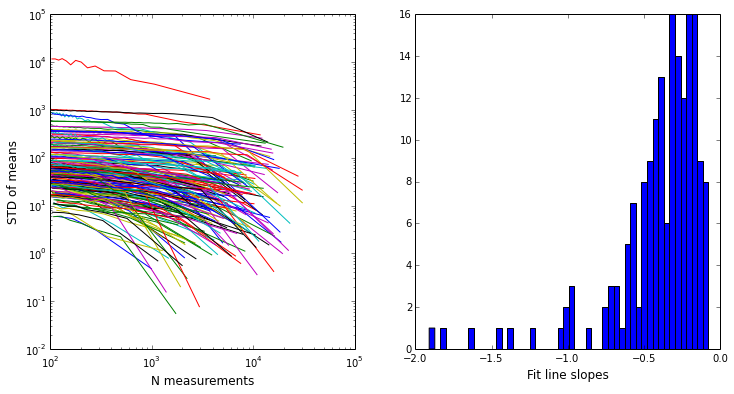

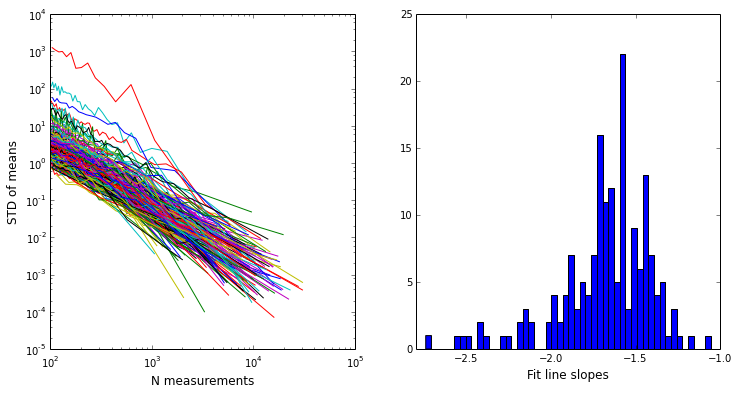

In [84]:
roll_len = int(np.floor(10*60))
roll_type = 'triang'

line_fits = []
io_sub_line_fits = []

for i in np.unique(data.runcatid):
    plt.figure(1, figsize=(12,6))
    plt.subplot(121)
    source_df = retrieve_source(data, i)
    std_means, curvlength = std_of_means(source_df.f_int.values)
    plt.plot(curvlength,std_means)
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel('N measurements')
    plt.ylabel('STD of means')
    line_fits.append(np.polyfit(np.log10(curvlength),np.log10(std_means),1)[0])

    plt.figure(2, figsize=(12,6))
    plt.subplot(121)
    rolling = source_df.f_int.rolling(roll_len, win_type=roll_type)
    std_means, curvlength = std_of_means(source_df.f_int.values-rolling.mean())
    plt.plot(curvlength,std_means)
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel('N measurements')
    plt.ylabel('STD of means')
    io_sub_line_fits.append(np.polyfit(np.log10(curvlength),np.log10(std_means),1)[0])

line_fits = np.array(line_fits)
io_sub_line_fits = np.array(io_sub_line_fits)

plt.figure(1)
plt.subplot(122)
p = plt.hist(line_fits[np.isfinite(line_fits)],bins=50)
plt.xlabel('Fit line slopes')

plt.figure(2)
plt.subplot(122)
p1 = plt.hist(io_sub_line_fits[np.isfinite(io_sub_line_fits)],bins=50)
plt.xlabel('Fit line slopes')

# plt.figure(figsize=(10,8))
# source_df = retrieve_source(new_corrected, 84)
# std_means, curvlength = std_of_means(source_df.f_int.values)
# plt.plot(curvlength,std_means)

# plt.xscale('log')
# plt.yscale('log')

ValueError: zero-size array to reduction operation minimum which has no identity

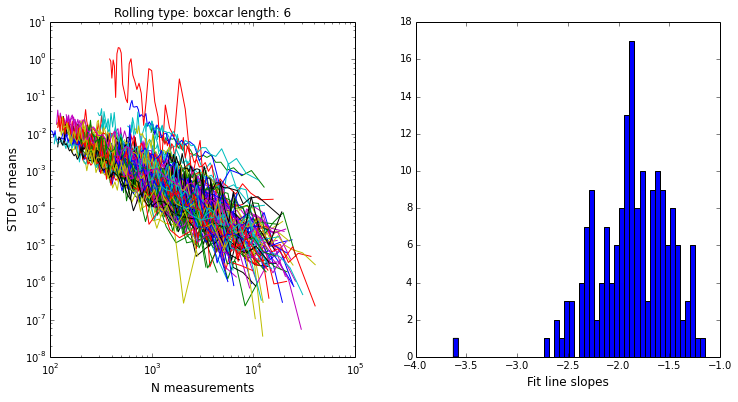

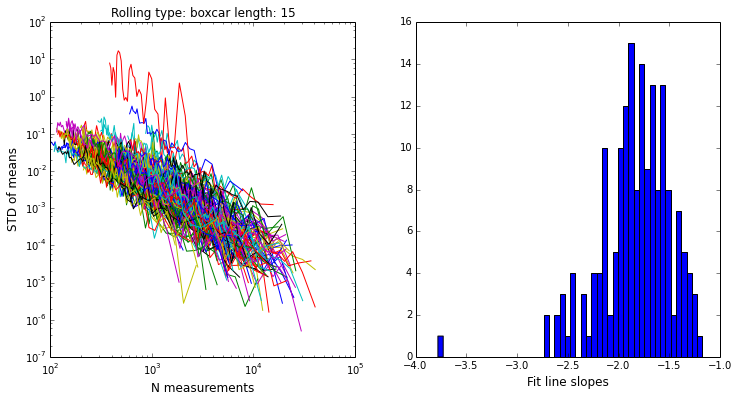

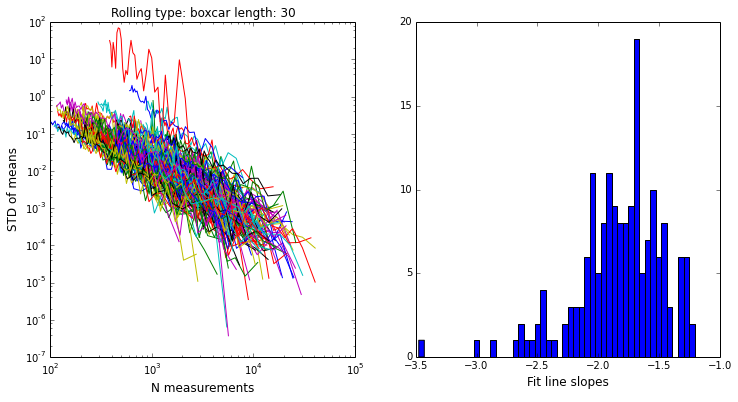

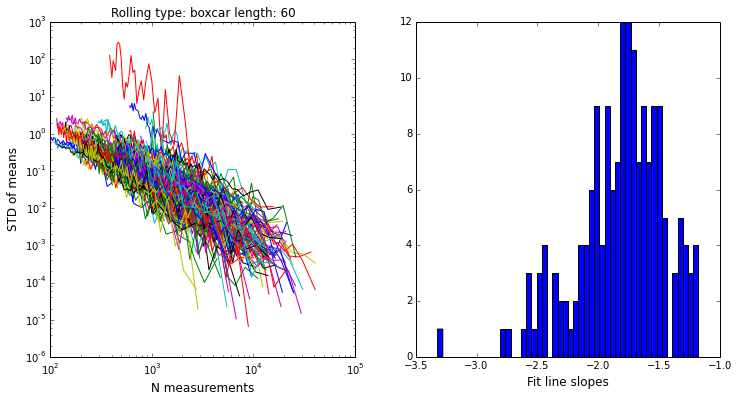

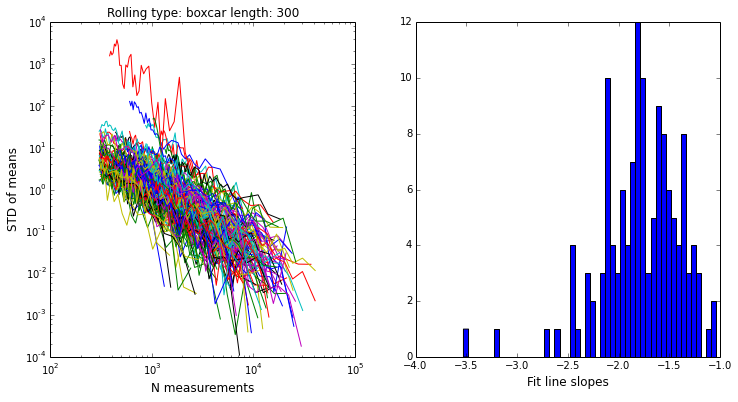

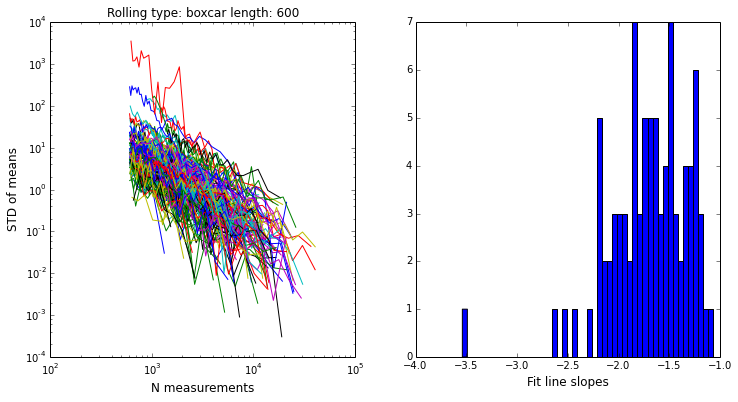

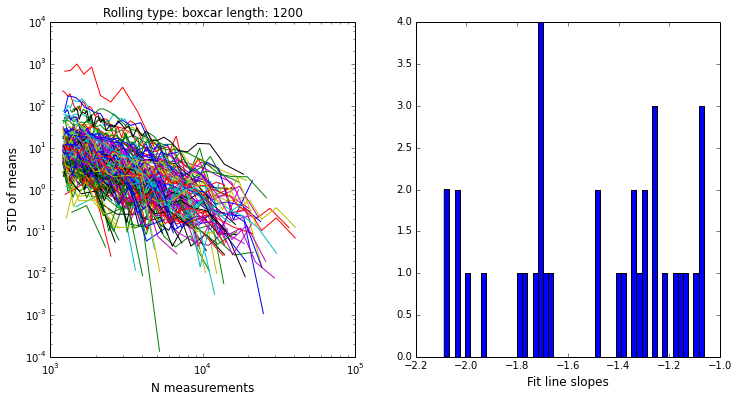

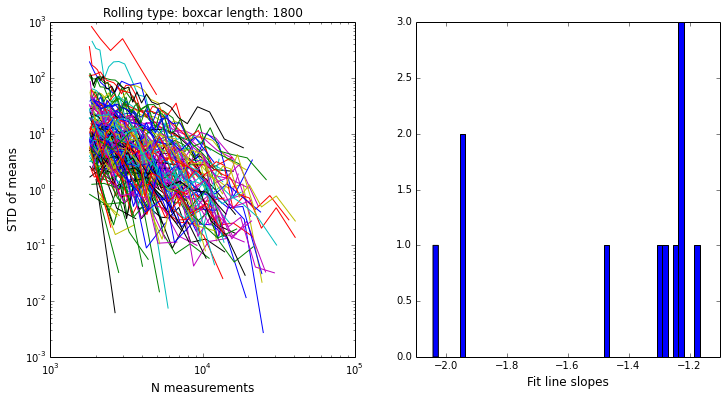

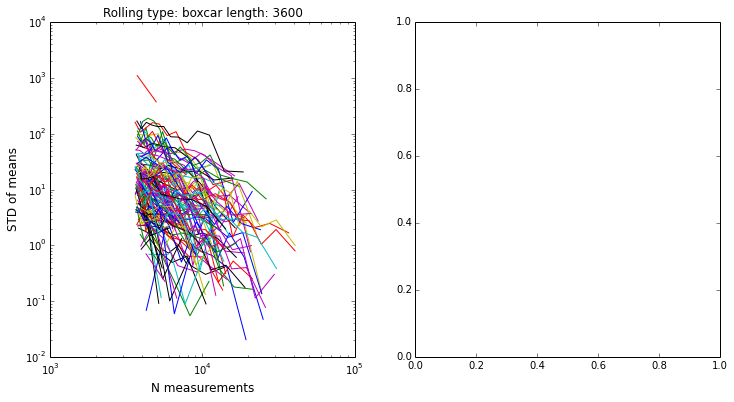

In [35]:
count = 0
for length in [0.1,0.25,0.5,1,5,10,20,30,60,120]:
    roll_len = int(np.floor(length*60))
    roll_type = 'boxcar'

    io_sub_line_fits = []

    for i in np.unique(data.runcatid):
        
        plt.figure(count, figsize=(12,6))
        plt.title("Rolling type: "+roll_type+" length: "+str(roll_len))
        plt.subplot(121)
        source_df = retrieve_source(data, i)
        rolling = source_df.f_int.rolling(roll_len, win_type=roll_type)
        std_means, curvlength = std_of_means(source_df.f_int.values-rolling.mean())
        plt.plot(curvlength,std_means)

        plt.xlabel('N measurements')
        plt.ylabel('STD of means')
        io_sub_line_fits.append(np.polyfit(np.log10(curvlength),np.log10(std_means),1)[0])

    line_fits = np.array(line_fits)
    io_sub_line_fits = np.array(io_sub_line_fits)

    
    plt.subplot(121)
    plt.xscale('log')
    plt.yscale('log')
    

    plt.figure(count)
    plt.subplot(122)
    p1 = plt.hist(io_sub_line_fits[np.isfinite(io_sub_line_fits)],bins=50)
    plt.xlabel('Fit line slopes')
    count += 1
    # plt.figure(figsize=(10,8))
    # source_df = retrieve_source(new_corrected, 84)
    # std_means, curvlength = std_of_means(source_df.f_int.values)
    # plt.plot(curvlength,std_means)

    # plt.xscale('log')
    # plt.yscale('log')

(array([ 1.,  1.,  4.,  1.,  3.,  2.,  4.,  4.,  2.,  4.,  4., 10.,  9.,
         9.,  4.,  5.,  7.,  2.,  4.,  5.,  3.,  2.,  1.,  0.,  0.,  5.,
         1.,  1.,  0.,  2.]),
 array([40.53489935, 41.28988704, 42.04487473, 42.79986242, 43.5548501 ,
        44.30983779, 45.06482548, 45.81981317, 46.57480086, 47.32978855,
        48.08477624, 48.83976393, 49.59475161, 50.3497393 , 51.10472699,
        51.85971468, 52.61470237, 53.36969006, 54.12467775, 54.87966543,
        55.63465312, 56.38964081, 57.1446285 , 57.89961619, 58.65460388,
        59.40959157, 60.16457926, 60.91956694, 61.67455463, 62.42954232,
        63.18453001]),
 <a list of 30 Patch objects>)

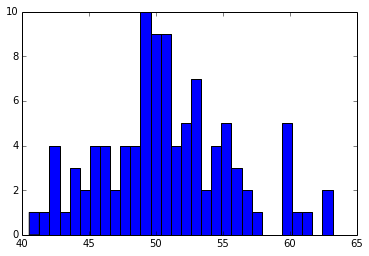

In [178]:
source_df = retrieve_source(data,3)
tmp_mean = []
n = 100
for i in range(n):
    new_index = len(clip(np.array(source_df.f_int.values)))*np.linspace(0,1,n+1)
    a = np.int(new_index[i])
    b = np.int(new_index[i+1])
    tmp_mean.append(np.nanmean(clip(source_df.f_int.values)[a:b]))

plt.hist(tmp_mean, bins=30)

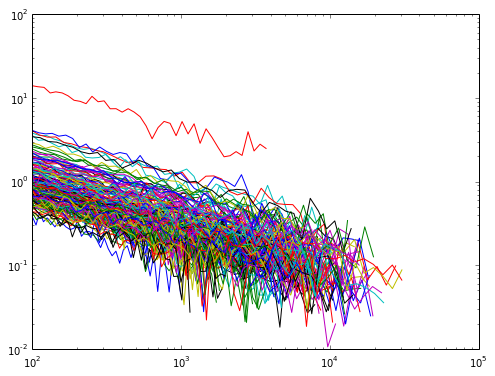

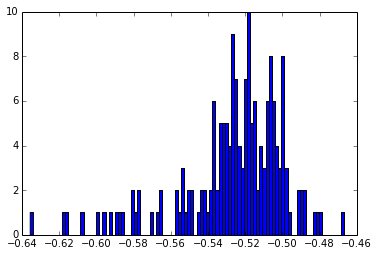

19.9412999153


In [78]:
def powlaw(x,A,B):
    return A*x**B

t1 = time.time()
all_mean_stds = []
for _ID in np.unique(data.runcatid):
    plt.figure(1,figsize=(8,6))
    source_df = retrieve_source(data,_ID)
    source_df = source_df.dropna()
    mean_stds = []
#     lens = len(source_df.f_int)*1/np.linspace(10,200,191, dtype=int)

#     for runs in np.ones(8):
    mean_stds = []
    lens = np.logspace(2,np.log10(len(source_df.f_int)/4),40, dtype=int)
    for i in lens:
        rand_set = np.random.choice(source_df.f_int,size=(i,len(source_df.f_int)/i), replace=False)
        mean_stds.append(np.std(np.mean(rand_set,axis=0)))

    plt.plot(lens,mean_stds)

#     fit = np.polyfit(np.log10(lens),np.log10(mean_stds),1)

    fit, cov = scipy.optimize.curve_fit(powlaw, lens, mean_stds)
#     print fit
    x_min = np.min(lens)
    x_max = np.max(lens)
#     plt.plot([x_min,x_max],[x_min**fit[0]*10**fit[1],x_max**fit[0]*10**fit[1] ])
#     plt.plot([x_min,x_max],[powlaw(x_min,fit[0],fit[1]),powlaw(x_max,fit[0],fit[1]) ])
    plt.yscale("log")
    plt.xscale("log")
#     print fit[0], fit[1]
    all_mean_stds.append(fit[1])

plt.figure(2)
hist = plt.hist(all_mean_stds, bins=100)
# plt.xlim([-1,0])
plt.show()
print time.time() - t1

NameError: name 'powlaw' is not defined

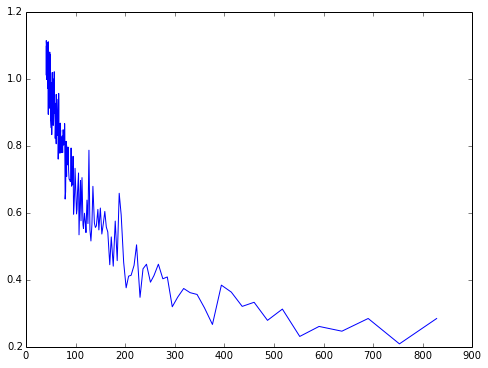

In [13]:
all_mean_stds = []
t1 = time.time()

roll_len = int(np.floor(2*60))
roll_type = 'triang'

for _ID in np.unique(data.runcatid):
    plt.figure(1,figsize=(8,6))
    source_df = retrieve_source(data,_ID)
    
    rolling = source_df.f_int.rolling(roll_len, win_type=roll_type)
    source_df.f_int = source_df.f_int-rolling.mean()
    source_df = source_df.dropna()
    
    source_df.dropna()
#     mean_stds = []
#     lens = len(source_df.f_int)*1/np.linspace(10,200,191, dtype=int)
    for runs in np.ones(8):
        mean_stds = []
        lens = len(source_df.f_int)*1/np.linspace(10,200,191, dtype=int)
        for i in lens:
            rand_set = np.random.choice(source_df.f_int,size=(i,len(source_df.f_int)/i), replace=False)
            mean_stds.append(np.std(np.mean(rand_set,axis=0)))

        plt.plot(lens,mean_stds)

    #     fit = np.polyfit(np.log10(lens),np.log10(mean_stds),1)

        fit, cov = scipy.optimize.curve_fit(powlaw, lens, mean_stds)
    #     print fit
        x_min = np.min(lens)
        x_max = np.max(lens)
    #     plt.plot([x_min,x_max],[x_min**fit[0]*10**fit[1],x_max**fit[0]*10**fit[1] ])
        plt.plot([x_min,x_max],[powlaw(x_min,fit[0],fit[1]),powlaw(x_max,fit[0],fit[1]) ])
        plt.yscale("log")
        plt.xscale("log")
    #     print fit[0], fit[1]
        all_mean_stds.append(fit[1])
    
plt.figure(2)
hist = plt.hist(all_mean_stds, bins=100)
plt.show()
print time.time() - t1

In [15]:
np.logspace(2,np.log10(len(source_df.f_int)/2),40, dtype=int)

array([ 100,  110,  121,  133,  146,  161,  178,  196,  215,  237,  261,
        287,  316,  348,  384,  422,  465,  512,  564,  621,  684,  753,
        829,  912, 1004, 1106, 1217, 1340, 1476, 1624, 1788, 1969, 2168,
       2387, 2627, 2893, 3185, 3506, 3860, 4250])

In [55]:
times.values[-10]

numpy.datetime64('2016-11-14T12:43:10.804000000')

### Drop source from Dataframe. 

In [34]:
# sidelobe sources dropped  120 15 158 141 86 

runcat_to_drop = 86

print data.shape
data.drop(data[data.runcatid == runcat_to_drop].index, axis=0, inplace=True)
print data.shape

(6580484, 12)
(6580484, 12)


In [36]:
data.to_csv("FINAL_fb_flux_aartcat.csv")

# Beam model test

In [19]:
from astropy.coordinates import AltAz, EarthLocation,SkyCoord, get_sun
from astropy.time import Time
from astropy import units as u

In [21]:
times = pd.to_datetime(data.taustart_ts)

In [23]:

times = pd.Index(times)
times = times.tz_localize('UTC')


In [120]:
altaz = [AltAz(obstime=x, location=CS002) for x in new_corrected.taustart_ts]

KeyboardInterrupt: 

In [25]:
#times, pd.to_datetime(new_corrected.taustart_ts)
t1 = time.time()
utc_times = [] 
for x in times :
    utc_times.append(Time(x))
print time.time() - t1 

1307.22421288


In [128]:
print len(utc_times)

144535


In [129]:
altaz = position[:len(utc_times)].transform_to(AltAz(obstime=utc_times, location=CS002))

In [27]:
CS002 = EarthLocation.from_geocentric (3826577.109500000, 461022.900196000, 5064892.758, 'm')
position = SkyCoord(data.ra*u.degree, data.decl*u.degree)
altaz = position.transform_to(AltAz(obstime=utc_times, location=CS002))
#galactic = c.transform_to(AltAz(obstime=TableTrans[:,-1], location=CS002))


In [55]:
flux_mode = np.array([]) 
for _ID in np.unique(data.runcatid):
    flux_mode = np.append(flux_mode, ref_cat[ref_cat.runcatid == _ID].f_int.values*np.ones(len(data[data.runcatid == _ID])))

In [44]:
test_array = np.array([])

for i in range(10):
    test_array = np.append(test_array, np.linspace(0,i,i))

In [38]:
import pickle
with open('alt_az_all.pkl','wb') as output:
    pickle.dump(altaz, output, pickle.HIGHEST_PROTOCOL)

In [39]:
with open('alt_az_all.pkl', 'rb') as _input:
    space_stuff = pickle.load(_input)

In [162]:
font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 18}

matplotlib.rc('font', **font)

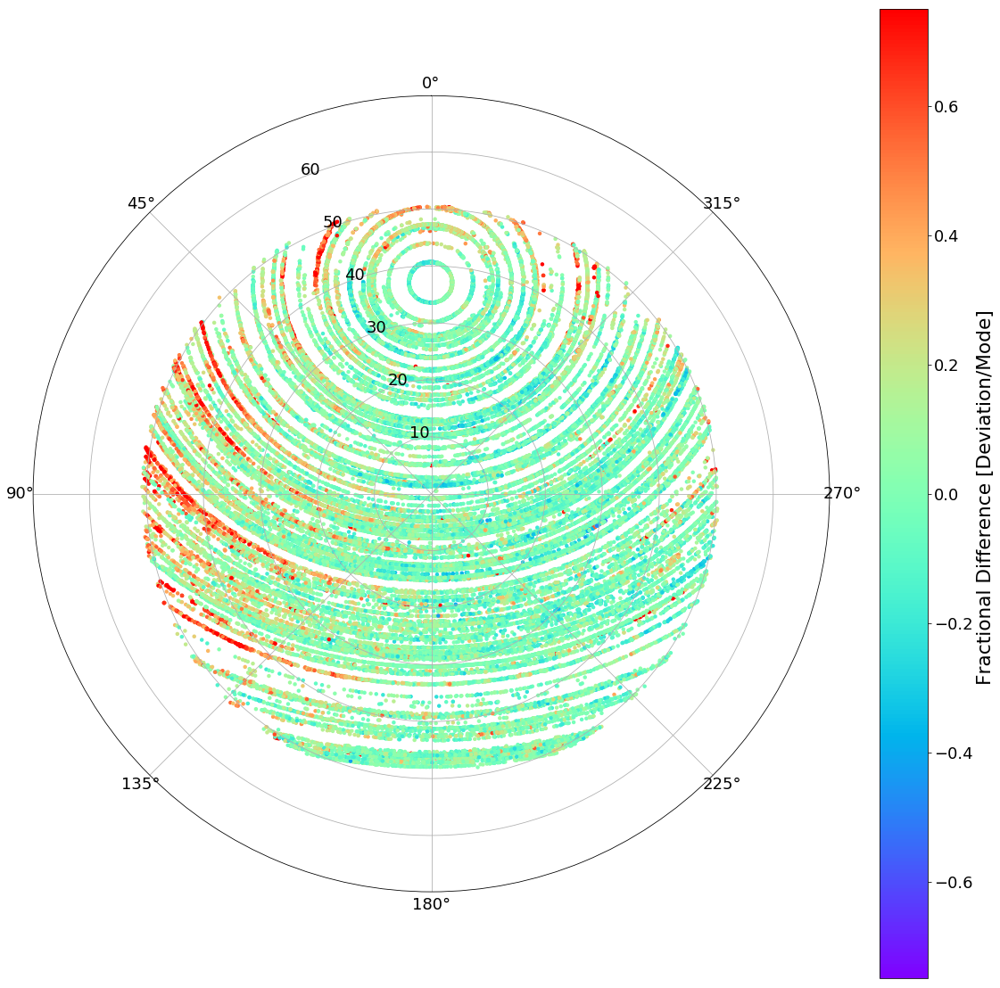

In [177]:
plt.figure(figsize=(20,20))
ax = plt.subplot(projection='polar')
plt.scatter(np.array(altaz.az.rad)[::100],
            np.array(np.abs(90-altaz.alt.deg))[::100],
            c=deviation[::100]/flux_mode[::100],
            vmin=-0.75,vmax=0.75,
            cmap="rainbow", lw=0, s=20 )
# plt.plot(altaz.az.rad[:1000],np.abs(90-altaz.alt.deg)[:1000], ".", c=col_tup[:1000], lw=0 )
ax.set_theta_zero_location("N")
# plt.scatter()
# plt.savefig("skyout.png")
plt.colorbar(label="Fractional Difference [Deviation/Mode] ")
plt.show()

In [160]:
x, y = pol2cart(np.abs(90-altaz.alt.deg),altaz.az.rad)

In [129]:
def rgb(minimum, maximum, value):
    minimum, maximum = float(minimum), float(maximum)
    ratio = 2 * (value-minimum) / (maximum - minimum)
#     b = np.int(np.max(0, 255*(1 - ratio)))
    
    b = np.array(np.max(np.array([np.zeros(len(ratio)), 255*(np.ones(len(ratio)) - ratio)]), axis=0),dtype=int)
    
    
#     r = np.int(np.max(0, 255*(ratio - 1)))
    
    r = np.array(np.max(np.array([np.zeros(len(ratio)), 255*(ratio - np.ones(len(ratio)))]), axis=0),dtype=int)
    
    g = np.array(255*np.ones(len(ratio)) - b - r, dtype=int)
    return r, g, b

deviation = np.array(data.f_int.values-np.array(flux_mode))
colours = rgb(np.min(deviation),np.max(deviation),deviation)

In [85]:
minimum = np.min(deviation)
maximum = np.max(deviation)
value = deviation

minimum, maximum = float(minimum), float(maximum)
ratio = 2 * (value-minimum) / (maximum - minimum)
b = np.max(np.array([np.zeros(len(ratio)), 255*(np.ones(len(ratio)) - ratio)]), axis=0)

[0.39697608 0.39035003 0.40325449 ... 0.39113061 0.38838755 0.39012563]


In [130]:
col_tup = [(colours[0][i],colours[1][i],colours[2][i]) for i in range(len(colours[0]))]

In [1]:
len(col_tup[::100])

NameError: name 'col_tup' is not defined

In [ ]:
pol2cart(np.abs(90-data[data.runcatid == i].iloc[0].wm_decl),np.deg2rad(data[data.runcatid == i].iloc[0].wm_ra))

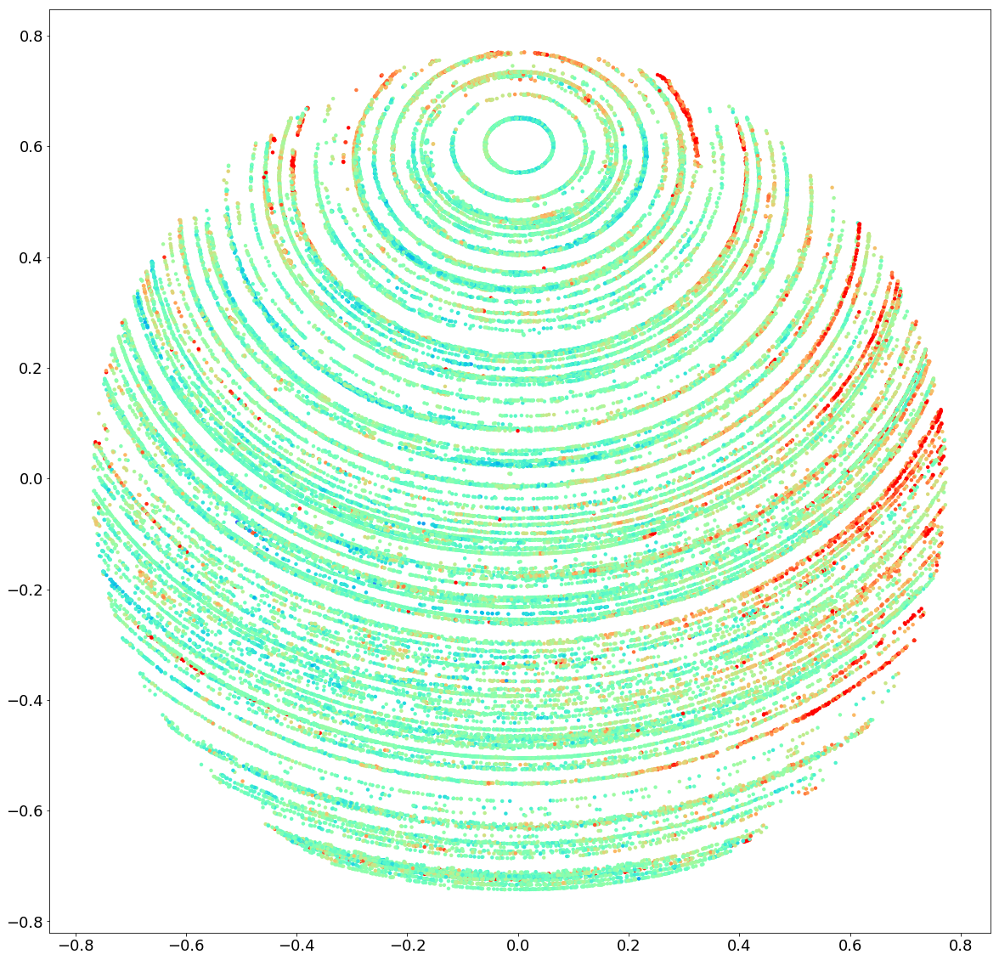

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.
ERROR:tornado.general:Uncaught exception, closing connection.
Traceback (most recent call last):
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 414, in _run_callback
    callback(*args, **kwargs)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/tornado/stack_context.py", line 277, in null_wrapper
    return fn(*args, **kwargs)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 283, in dispatcher
    return self.dispatch_shell(stream, msg)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 235, in dispatch_shell
    handler(stream, idents, msg)
  File "/scratch/mkuiack/trapenv/local/lib/python2.7/site-packages/ipyk

In [ ]:
f_s = np.linspace(1,2*np.pi,101)

def pol2cart(rho, phi,f):
    rho = np.sin(f*np.deg2rad(rho))
    x = rho * np.cos(phi)
    y = rho * np.sin(phi)
    return (x, y)
count = 0
for f in f_s:

    x, y = pol2cart(np.abs(90-altaz.alt.deg),altaz.az.rad,f)
    # plt.figure(figsize=(10,10))
    # plt.plot(y[::100],x[,".")
    # plt.show()

    plt.figure(figsize=(20,20))
    ax = plt.subplot(111)
    ax.set_aspect(1)
    # ax = plt.subplot(projection='polar')
    plt.scatter(y[::100],
                x[::100],
                c=deviation[::100]/flux_mode[::100],
                vmin=-0.75,vmax=0.75,
                cmap="rainbow", lw=0, s=20 )
    plt.savefig(str(count).zfill(3)+".png")
    count += 1
# plt.plot(altaz.az.rad[:1000],np.abs(90-altaz.alt.deg)[:1000], ".", c=col_tup[:1000], lw=0 )
# ax.set_theta_zero_location("N")
# plt.scatter()
# plt.savefig("skyout.png")
# plt.xlim([np.min(x),np.max(x)])
# plt.ylim([np.min(y),np.max(y)])
# plt.colorbar(label="Fractional Difference [Deviation/Mode] ")
# plt.show()

In [24]:
plt.subplot(projection="polar")
plt.plot(0,0,".")

TypeError: 'numpy.float64' object cannot be interpreted as an index

In [25]:
import numpy as np
import matplotlib.pyplot as plt


r = np.arange(0, 2, 0.01)
theta = 2 * np.pi * r

ax = plt.subplot(111, projection='polar')
ax.plot(theta, r)
ax.set_rmax(2)
ax.set_rticks([0.5, 1, 1.5, 2])  # Less radial ticks
ax.set_rlabel_position(-22.5)  # Move radial labels away from plotted line
ax.grid(True)

ax.set_title("A line plot on a polar axis", va='bottom')
plt.show()

AttributeError: 'PolarAxesSubplot' object has no attribute 'set_rlabel_position'

TypeError: 'numpy.float64' object cannot be interpreted as an index

In [165]:
print np.__version__
print matplotlib.__version__

1.14.0
2.1.2


In [209]:
space_stuff = 90*np.tan(2.*np.arcsin(np.linspace(0,90.,10)/(2.*90)))
print space_stuff
(space_stuff[-1]-space_stuff[-2])/(space_stuff[-1]+space_stuff[-2])

[  0.          10.04657185  20.37935372  31.32042238  43.27379698
  56.79728036  72.73098321  92.45458486 118.46582814 155.88457268]


0.136390340350033